In [ ]:
! pip install --upgrade xarray zarr gcsfs cftime nc-time-axis global_land_mask s3fs datetime cmaps cartopy adjustText

In [ ]:
from matplotlib import pyplot as plt
import matplotlib.patches as mpatches
from matplotlib.colors import LinearSegmentedColormap
from matplotlib.colors import ListedColormap
import numpy as np
import pandas as pd
import xarray as xr
import zarr
import gcsfs
from global_land_mask import globe
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from scipy.optimize import curve_fit
from sklearn.metrics import mean_squared_error
import time
import cftime
from adjustText import adjust_text
from sklearn.linear_model import LinearRegression
regr = LinearRegression()

import matplotlib as mpl
mpl.rcParams['figure.dpi']= 600
plt.rcParams.update({'font.size': 10})
mpl.rcParams['axes.linewidth'] = 0.3

In [ ]:
region = str(input('Enter the region for comparision\n I=India, S=Sahel, S2=Western Sahel\n'))

if region=='I':
        lat1, lat2, lon1, lon2 = 10, 30, 70, 90
        region='India'
elif region=='S':
        lat1, lat2, lon1, lon2 = 10, 20, -10, 35
        region='Sahel'
elif region=='S2':
        lat1, lat2, lon1, lon2 = 10, 15, -10, 35
        region='Western Sahel'
else:
    print('Please enter proper code')

Enter the region for comparision
 I=India, S=Sahel, S2=Western Sahel
S


In [ ]:
#Models that have good drying trends
models = ['MPI-ESM-1-2-HAM', 'MIROC6', 'CMCC-CM2-SR5', 'TaiESM1']

In [ ]:
df = pd.read_csv('https://storage.googleapis.com/cmip6/cmip6-zarr-consolidated-stores.csv')
df_ta = df.query("table_id == 'Amon' & variable_id == ['pr', 'evspsbl', 'prw', 'rsut', 'rlut', 'rsdt', 'rlutcs'] & experiment_id == ['historical'] & member_id=='r1i1p1f1'")
gcs = gcsfs.GCSFileSystem(token='anon')

# Contribution

In [ ]:
Taigamma = np.array([6.9360204, 6.9286575, 6.937054 , 6.938216 , 6.9514093, 6.9551153,
       6.973829 , 6.9467216, 6.948621 , 6.9556837, 6.967073 , 6.958537 ,
       6.963178 , 6.9545665, 6.9508476, 6.9232855, 6.9000487])
Mpigamma = np.array([6.8980217, 6.89776  , 6.885998 , 6.8825727, 6.8916655, 6.9052567,
       6.9211516, 6.8843694, 6.8903313, 6.889381 , 6.912904 , 6.920447 ,
       6.9129477, 6.890246 , 6.8690896, 6.842173 , 6.806621 ])
Mirocgamma = np.array([7.07219, 7.07698, 7.0928 , 7.07584, 7.07585, 7.09451, 7.08565,
       7.07659, 7.07944, 7.07024, 7.08143, 7.1089 , 7.07923, 7.0871 ,
       7.06635, 7.04986, 7.04606])
Cmccgamma = np.array([6.926326 , 6.9254217, 6.9317713, 6.9409027, 6.9386067, 6.9393973,
       6.916469 , 6.8998833, 6.9168687, 6.911807 , 6.9107633, 6.8872557,
       6.867475 , 6.891155 , 6.8600707, 6.8101726, 6.820633 ])

In [ ]:
gammas = [Mpigamma, Mirocgamma, Cmccgamma, Taigamma]

MPI-ESM-1-2-HAM loaded
MIROC6 loaded
CMCC-CM2-SR5 loaded
TaiESM1 loaded
Qcont =  [27.706635   8.869152  17.878836   2.4394429]
Tcont =  [72.29338  91.13082  82.12118  97.560555]
TaiESM1 done, time taken: 11.53331184387207
MPI-ESM-1-2-HAM loaded
MIROC6 loaded
CMCC-CM2-SR5 loaded
TaiESM1 loaded
Qcont =  [48.34368    5.9022436 10.130866  16.667953 ]
Tcont =  [51.656322 94.09775  89.86913  83.332054]
TaiESM1 done, time taken: 8.680391550064087


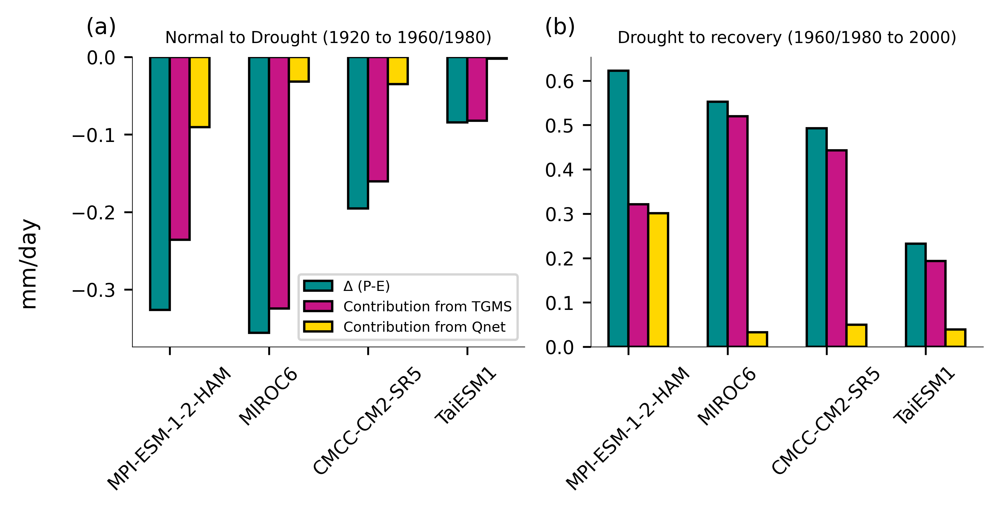

In [ ]:
X = np.arange(1850, 2020, 10)
plt.rcParams['figure.figsize'] = [6,3]
fig, axes = plt.subplot_mosaic([['(a)','(b)']])
labels = ['(a)', '(b)']

for j in range(len(labels)):
  Pref=[]
  Plow=[]
  Qref=[]
  Qlow=[]
  for i in models:
    start = time.time()
    df_sel = df_ta.query('source_id == '+'"'+i+'"')
    zstores = df_sel.zstore.values
    mappers = [gcs.get_mapper(zstore) for zstore in zstores]
    ds_list = []
    for mapper in mappers:
      ds_list.append(xr.open_zarr(mapper, consolidated=True))

    ds = xr.merge(ds_list, compat='override')
    print(i +' loaded')
    ds.coords['lon'] = (ds.coords['lon']+180) % 360 -180
    ds2 = ds.sortby(ds.lon)
    ds3 = ds2.sel(lat=slice(lat1,lat2), lon=slice(lon1,lon2))

    lon_grid, lat_grid = np.meshgrid(ds3.lon, ds3.lat)
    mask = globe.is_land(lat_grid, lon_grid)

    jjas = ds3.time.dt.month.isin(range(6, 10))
    ds4 = ds3.sel(time=jjas)
    ds5 = ds4.resample(time="10YS").mean()
    ds6 = ds5.where(mask>0).mean(dim=['lat','lon']).squeeze()
    PE = 86400*(ds6.pr-ds6.evspsbl)
    Qnet = (ds6.rsdt-ds6.rsut-ds6.rlut)/28.96

    if i=='CMCC-CM2-SR5':
      a=13
    else:
      a=11 # for recovery from drought (1960)

    if j==0:
      b=7 # for 1920
    else:
      b=-2 # for 2000-2010
    Pref.append(np.array(PE[a]))
    Qref.append(np.array(Qnet[a]))
    Plow.append(np.array(PE[b]))
    Qlow.append(np.array(Qnet[b]))



  Q=Qref
  P=Pref
  G=np.divide(Q,P)
  Glow =  np.divide(Qlow, Plow)

  dQ = np.subtract(Qlow,Qref)
  dG = np.subtract(Glow,G)

  dP = []
  Qcont = []
  Tcont = []
  for k in range(len(Plow)):
    Qcont.append((dQ[k]*P[k]/Q[k])/(1+(dG[k]/G[k])))
    Tcont.append((-dG[k]*P[k]/G[k])/(1+(dG[k]/G[k])))
    dP.append(Plow[k]-Pref[k])

  if b==7:
    # run this for Drought diagnostics
    ar1=np.array(dP)
    ar2=np.array(Tcont)
    ar3=np.array(Qcont)
    dP=-1*ar1
    Tcont=-1*ar2
    Qcont=-1*ar3

  ind = np.arange(1,5,1) # the x locations for the groups
  width = 0.2     # the width of the bars

  axes[labels[j]].bar(ind-width/2, dP, width, color='darkcyan', edgecolor='black')
  axes[labels[j]].bar(ind+width/2, Tcont, width, bottom=0, color='mediumvioletred', edgecolor='black')
  axes[labels[j]].bar(ind+3*width/2, Qcont, width, color='gold', bottom=0, edgecolor='black')
  #axes[labels[j]].bar(ind+width/2, np.divide(Tcont, dP)*100, width, color='mediumvioletred', edgecolor='black')
  #axes[labels[j]].bar(ind+3*width/2, np.divide(Qcont, dP)*100, width, color='gold', bottom=0, edgecolor='black')
  axes[labels[j]].set_xticks(ind, models, rotation=45)        #shows all the x labels
  #axes[labels[j]].set_ylim(0,100)
  #axes[labels[j]].grid(ls="dashed", lw=0.3, dashes=(10,10))
  Titles = ['Normal to Drought (1920 to 1960/1980)', 'Drought to recovery (1960/1980 to 2000)']
  axes[labels[j]].set_title(Titles[j], fontsize=7)
  print('Qcont = ', np.divide(Qcont, dP)*100)
  print('Tcont = ', np.divide(Tcont, dP)*100)


  end = time.time()
  print(i +' done, time taken:', end-start)


axes[labels[0]].legend(['\u0394 (P-E)', 'Contribution from TGMS', 'Contribution from Qnet'], fontsize=6)
fig.supylabel('mm/day')
#fig.supylabel('% contribution')
#plt.legend(['\u0394 (P-E)', 'Contribution from TGMS', 'Contribution from Qnet'])
#plt.legend(['Contribution from TGMS', 'Contribution from Qnet'])
plt.tight_layout()

import matplotlib.transforms as mtransforms
for label, ax in axes.items():
    # label physical distance to the left and up:
    trans = mtransforms.ScaledTranslation(-20/72, 10/72, fig.dpi_scale_trans)
    plt.text(0.0, 1.0, label, transform=ax.transAxes + trans, fontsize='large')

plt.show()

MPI-ESM-1-2-HAM loaded
TaiESM1 loaded
E3SM-1-1 loaded
CMCC-CM2-SR5 loaded
CMCC-CM2-SR5 done, time taken: 27.76018977165222
MPI-ESM-1-2-HAM loaded
TaiESM1 loaded
E3SM-1-1 loaded
CMCC-CM2-SR5 loaded
CMCC-CM2-SR5 done, time taken: 18.30430579185486


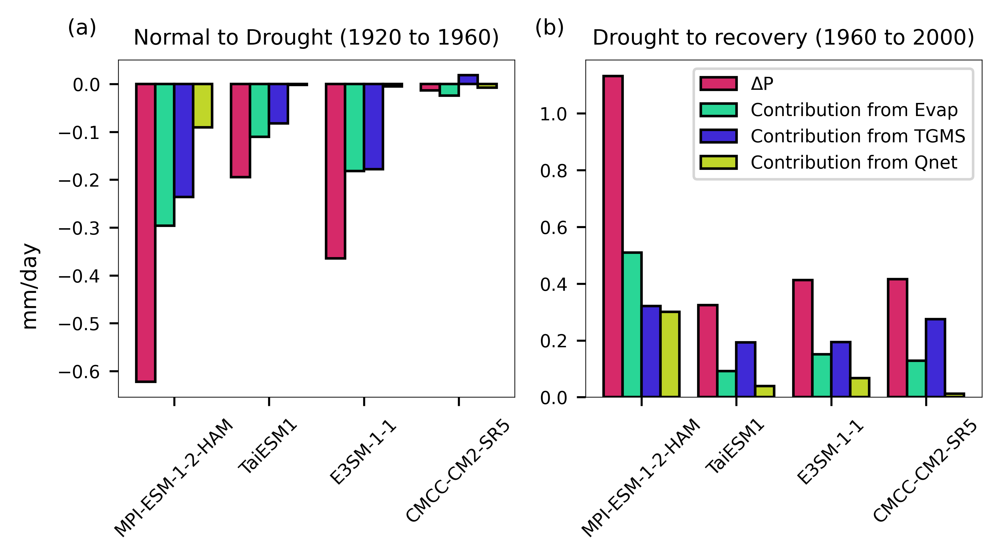

In [ ]:
# with evaporation contribution also (experiment)
X = np.arange(1850, 2020, 10)
plt.rcParams['figure.figsize'] = [5.5,3]
fig, axes = plt.subplot_mosaic([['(a)','(b)']])
labels = ['(a)', '(b)']


for j in range(len(labels)):
  Pref=[]
  Plow=[]
  Qref=[]
  Qlow=[]
  Eref=[]
  Elow=[]
  for i in models:
    start = time.time()
    df_sel = df_ta.query('source_id == '+'"'+i+'"')
    zstores = df_sel.zstore.values
    mappers = [gcs.get_mapper(zstore) for zstore in zstores]
    ds_list = []
    for mapper in mappers:
      ds_list.append(xr.open_zarr(mapper, consolidated=True))

    ds = xr.merge(ds_list, compat='override')
    print(i +' loaded')
    ds.coords['lon'] = (ds.coords['lon']+180) % 360 -180
    ds2 = ds.sortby(ds.lon)
    ds3 = ds2.sel(lat=slice(lat1,lat2), lon=slice(lon1,lon2))

    lon_grid, lat_grid = np.meshgrid(ds3.lon, ds3.lat)
    mask = globe.is_land(lat_grid, lon_grid)

    jjas = ds3.time.dt.month.isin(range(6, 10))
    ds4 = ds3.sel(time=jjas)
    ds5 = ds4.resample(time="10YS").mean()
    ds6 = ds5.where(mask>0).mean(dim=['lat','lon']).squeeze()
    E = 86400*(ds6.evspsbl)
    PE = 86400*(ds6.pr-ds6.evspsbl)
    Qnet = (ds6.rsdt-ds6.rsut-ds6.rlut)/26.16

    a=11 # for recovery from drought (1960)
    if j==0:
      b=7 # for 1920
    else:
      b=-2 # for 2000-2010
    Pref.append(np.array(PE[a]))
    Qref.append(np.array(Qnet[a]))
    Plow.append(np.array(PE[b]))
    Qlow.append(np.array(Qnet[b]))
    Eref.append(np.array(E[a]))
    Elow.append(np.array(E[b]))



  Q=Qref
  P=Pref
  G=np.divide(Q,P)
  Glow =  np.divide(Qlow, Plow)

  dQ = np.subtract(Qlow,Qref)
  dG = np.subtract(Glow,G)

  dP = []
  dE = []
  Qcont = []
  Tcont = []
  for k in range(len(Plow)):
    Qcont.append((dQ[k]*P[k]/Q[k])/(1+(dG[k]/G[k])))
    Tcont.append((-dG[k]*P[k]/G[k])/(1+(dG[k]/G[k])))
    dP.append(Plow[k]-Pref[k])
    dE.append(Elow[k]-Eref[k])

  if b==7:
    # run this for Drought diagnostics
    ar1=np.array(dP)
    ar2=np.array(Tcont)
    ar3=np.array(Qcont)
    ar4=np.array(dE)
    dP=-1*ar1
    Tcont=-1*ar2
    Qcont=-1*ar3
    dE=-1*ar4

  ind = np.arange(1,5,1) # the x locations for the groups
  width = 0.2     # the width of the bars

  axes[labels[j]].bar(ind-3*width/2, np.add(dP,dE), width, color=[(0.839, 0.161, 0.412)], edgecolor='black')
  #axes[labels[j]].bar(ind-width/2, dE, width, color=[(0.161, 0.839, 0.588)], edgecolor='black') (Evaporation contribution)
  axes[labels[j]].bar(ind+width/2, Tcont, width, color=[(0.247, 0.161, 0.839)], edgecolor='black')
  axes[labels[j]].bar(ind+3*width/2, Qcont, width, color=[(0.753, 0.839, 0.161)], bottom=0, edgecolor='black')
  axes[labels[j]].set_xticks(ind, models, rotation=45)        #shows all the x labels
  #axes[labels[j]].grid(ls="dashed", lw=0.3, dashes=(10,10))
  Titles = ['Normal to Drought (1920 to 1960)', 'Drought to recovery (1960 to 2000)']
  axes[labels[j]].set_title(Titles[j])
  plt.legend(['\u0394P', 'Contribution from Evap', 'Contribution from TGMS', 'Contribution from Qnet'])

  end = time.time()
  print(i +' done, time taken:', end-start)



fig.supylabel('mm/day')
plt.legend(['\u0394P', 'Contribution from Evap', 'Contribution from TGMS', 'Contribution from Qnet'])
plt.tight_layout()

import matplotlib.transforms as mtransforms
for label, ax in axes.items():
    # label physical distance to the left and up:
    trans = mtransforms.ScaledTranslation(-20/72, 10/72, fig.dpi_scale_trans)
    plt.text(0.0, 1.0, label, transform=ax.transAxes + trans, fontsize='large')

plt.show()

In [ ]:
#New calculation for all models
tspread1 = []
qspread1 = []
dpspread1 = []
tspread2 = []
qspread2 = []
dpspread2 = []
c1list = []
c2list = []
c3list = []
for i in range(len(models)):
  df_sel = df_ta.query('source_id == '+'"'+models[i]+'"')
  zstores = df_sel.zstore.values
  mappers = [gcs.get_mapper(zstore) for zstore in zstores]
  ds = xr.open_mfdataset(mappers, engine='zarr', consolidated=True, compat='override')
  print(models[i] +' loaded')
  grid1 = ds.sel(lat=slice(lat1,lat2), lon=slice(lon1,lon2))
  lon_grid, lat_grid = np.meshgrid(grid1.lon, grid1.lat)
  mask1 = globe.is_land(lat_grid, lon_grid)

  months = grid1.time.dt.month.isin(range(6, 10)) #JJAS
  clim = grid1.sel(time=months)
  clim2 = clim.resample(time="10YS").mean()  # For decadal
  clim3 = clim2.where(mask1>0).mean(dim=['lat', 'lon'])
  Pwat = clim3.prw
  PE = 86400*26.16*(clim3.pr-clim3.evspsbl)
  Qnet = clim3.rsdt - clim3.rsut - clim3.rlut
  E = 86400*26.16*(clim3.evspsbl)
  Pr = 86400*(clim3.pr)

  TGMS = Qnet/PE
  rec = 1/Pwat

  def objective(X, a, b, c):
    x,y = X
    return a*x + b*y*x + c

  x1, y1 = rec, xr.DataArray(gammas[i], coords=[PE.time], dims='time')
  lower_bounds = [0, -np.inf, -np.inf]
  upper_bounds = [np.inf, 0, np.inf] # This is the key change
  popt1, _ = curve_fit(objective, (x1, y1), TGMS, bounds=(lower_bounds, upper_bounds))
  c1, c2, c3= popt1
  c1list.append(c1)
  c2list.append(c2)
  c3list.append(c3)
  print(popt1)

  drought = PE.sel(time=slice('1950', '1980'))
  drought_sel = drought.argmin(dim='time')
  recovery = PE.sel(time=slice('1990', '2010'))
  recovery_sel = recovery.argmax(dim='time')

  normal = PE.sel(time=slice('1900', '1920'))
  normal_an = abs(normal-np.mean(PE))
  normal_sel = normal_an.argmin(dim='time')

  a = drought_sel.values
  b = recovery_sel.values
  c = normal_sel.values

  #Reference values
  PE1 = np.average(PE.sel(time=drought.time[a]))/26.16
  Q1 = np.average(Qnet.sel(time=drought.time[a]))/26.16
  G1 = Q1/PE1

  PE2 = np.average(PE.sel(time=recovery.time[b]))/26.16
  Q2 = np.average(Qnet.sel(time=recovery.time[b]))/26.16
  G2 = Q2/PE2

  PE3 = np.average(PE.sel(time=normal.time[c]))/26.16
  Q3 = np.average(Qnet.sel(time=normal.time[c]))/26.16
  G3 = Q3/PE3

  dP1 = PE1-PE3
  dQ1 = Q1-Q3
  dG1 = G1 - G3

  dP2 = PE2-PE1
  dQ2 = Q2-Q1
  dG2 = G2 - G1

  tspread1.append((-dG1*PE3/G3)/(1+(dG1/G3)))
  qspread1.append((dQ1*PE3/Q3)/(1+(dG1/G3)))
  dpspread1.append(dP1)

  tspread2.append((-dG2*PE1/G1)/(1+(dG2/G1)))
  qspread2.append((dQ2*PE1/Q1)/(1+(dG2/G1)))
  dpspread2.append(dP2)

FGOALS-g3 loaded
[32525.23512914 -4201.64652496  -166.88011997]
MPI-ESM1-2-HR loaded
[ 2.50297049e+02 -4.45579988e-16 -3.26050646e+00]
CAS-ESM2-0 loaded
[ 3.19244020e+02 -3.10904613e-05 -5.74374217e+00]
CanESM5 loaded
[ 1.00968360e-15 -1.67806384e+02  2.68424957e+01]
MPI-ESM1-2-LR loaded
[1403.02348783 -179.39083253   -1.68278473]
BCC-CSM2-MR loaded
[2584.56636571 -316.44518786   -8.6881426 ]
INM-CM4-8 loaded
[ 1.46650549e+03 -1.54624812e-12 -3.22184990e+01]
AWI-CM-1-1-MR loaded
[ 4.27054675e+02 -2.60488042e-17 -9.30956265e+00]
KACE-1-0-G loaded
[6009.50897401 -708.58948311  -29.99765896]
MRI-ESM2-0 loaded
[ 79025.65256228 -10430.43317684   -213.98667383]
CESM2-FV2 loaded
[430.80057486 -44.49431954  -2.33812367]
IPSL-CM6A-LR loaded
[5310.41891979 -698.34718154  -16.11918129]
CESM2 loaded
[516.7967904  -47.41824695  -4.03262544]
CESM2-WACCM-FV2 loaded
[ 1.30203829e+02 -1.07517736e+01 -7.72931199e-02]
CESM2-WACCM loaded
[ 1.62140868e+02 -3.53341488e-16 -3.10511432e+00]
TaiESM1 loaded
[ 5

/tmp/ipython-input-2445530730.py:24: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  triangle_cmap = plt.cm.get_cmap('tab10', len(dpspread1)) # Using a colormap for distinct colors


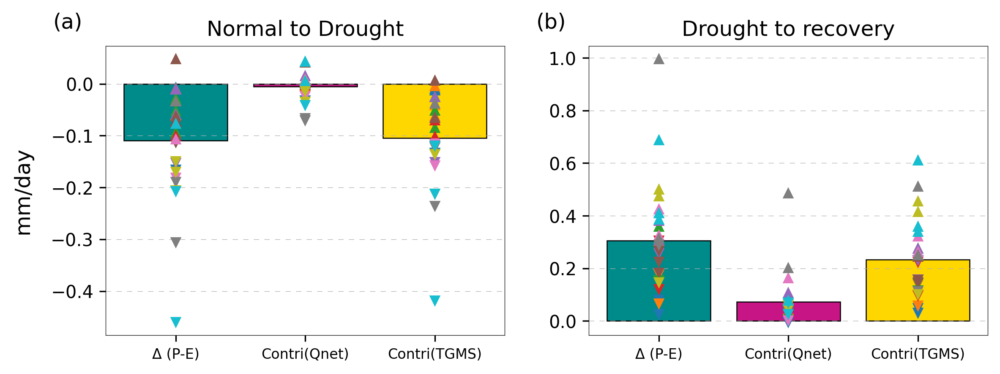

In [ ]:
X = np.arange(1850, 2020, 10)
plt.rcParams['figure.figsize'] = [8,3]
fig, axes = plt.subplot_mosaic([['(a)','(b)']])
labels = ['(a)', '(b)']

x_pos = np.arange(3)
labels = ['\u0394 (P-E)', 'Contri(Qnet)', 'Contri(TGMS)']
colors = ['darkcyan', 'mediumvioletred', 'gold']

# Calculate the average values
avg_dp1 = np.average(dpspread1)
avg_t1 = np.average(tspread1)
avg_q1 = np.average(qspread1)
avg_values1 = [avg_dp1, avg_q1, avg_t1]
spread_values1 = [dpspread1, qspread1, tspread1]

avg_dp2 = np.average(dpspread2)
avg_t2 = np.average(tspread2)
avg_q2 = np.average(qspread2)
avg_values2 = [avg_dp2, avg_q2, avg_t2]
spread_values2 = [dpspread2, qspread2, tspread2]

# Define a list of colors for the triangles using the deprecated method, as the new one is not available
triangle_cmap = plt.cm.get_cmap('tab10', len(dpspread1)) # Using a colormap for distinct colors

# Plot the bars
axes['(a)'].bar(x_pos, avg_values, color=colors, edgecolor='black', linewidth=0.6)
axes['(a)'].set_xticks(x_pos, labels, fontsize=8)
plt.ylabel('mm/day')
Titles = ['Normal to Drought', 'Drought to recovery']
axes['(a)'].set_title(Titles[0])
axes['(a)'].grid(axis='y', ls="dashed", lw=0.3, dashes=(10,10))
#axes['(a)'].legend(labels, fontsize=6)

axes['(b)'].bar(x_pos, avg_values2, color=colors, edgecolor='black', linewidth=0.6)
axes['(b)'].set_xticks(x_pos, labels, fontsize=8)
plt.ylabel(' ')
axes['(b)'].set_title(Titles[1])
axes['(b)'].grid(axis='y', ls="dashed", lw=0.3, dashes=(10,10))

# Add individual triangle markers for each spread value
for i in range(len(x_pos)):
    # Use a different set of colors for each bar's triangles, or cycle through a list
    # For simplicity, let's cycle through the colormap for each bar's triangles
    for j, value in enumerate(spread_values1[i]):
        if value >= avg_values1[i]:
            # Plot upward triangle if the value is above or equal to the mean
            axes['(a)'].plot(x_pos[i], value, '^', color=triangle_cmap(j % len(spread_values1[i])), markersize=5)
        else:
            # Plot downward triangle if the value is below the mean
            axes['(a)'].plot(x_pos[i], value, 'v', color=triangle_cmap(j % len(spread_values1[i])), markersize=5)
    for j, value in enumerate(spread_values2[i]):
        if value >= avg_values2[i]:
            # Plot upward triangle if the value is above or equal to the mean
            axes['(b)'].plot(x_pos[i], value, '^', color=triangle_cmap(j % len(spread_values2[i])), markersize=5)
        else:
            # Plot downward triangle if the value is below the mean
            axes['(b)'].plot(x_pos[i], value, 'v', color=triangle_cmap(j % len(spread_values2[i])), markersize=5)
fig.supylabel('mm/day')
plt.tight_layout()

import matplotlib.transforms as mtransforms
for label, ax in axes.items():
    # label physical distance to the left and up:
    trans = mtransforms.ScaledTranslation(-30/72, 10/72, fig.dpi_scale_trans)
    plt.text(0.0, 1.0, label, transform=ax.transAxes + trans, fontsize='large')

plt.show()

# All variables in one graph

E3SM-1-1-ECA done
NESM3 done
CMCC-CM2-HR4 done
MPI-ESM-1-2-HAM done
GFDL-CM4 done
AWI-ESM-1-1-LR done
CMCC-CM2-SR5 done
MIROC6 done
TaiESM1 done


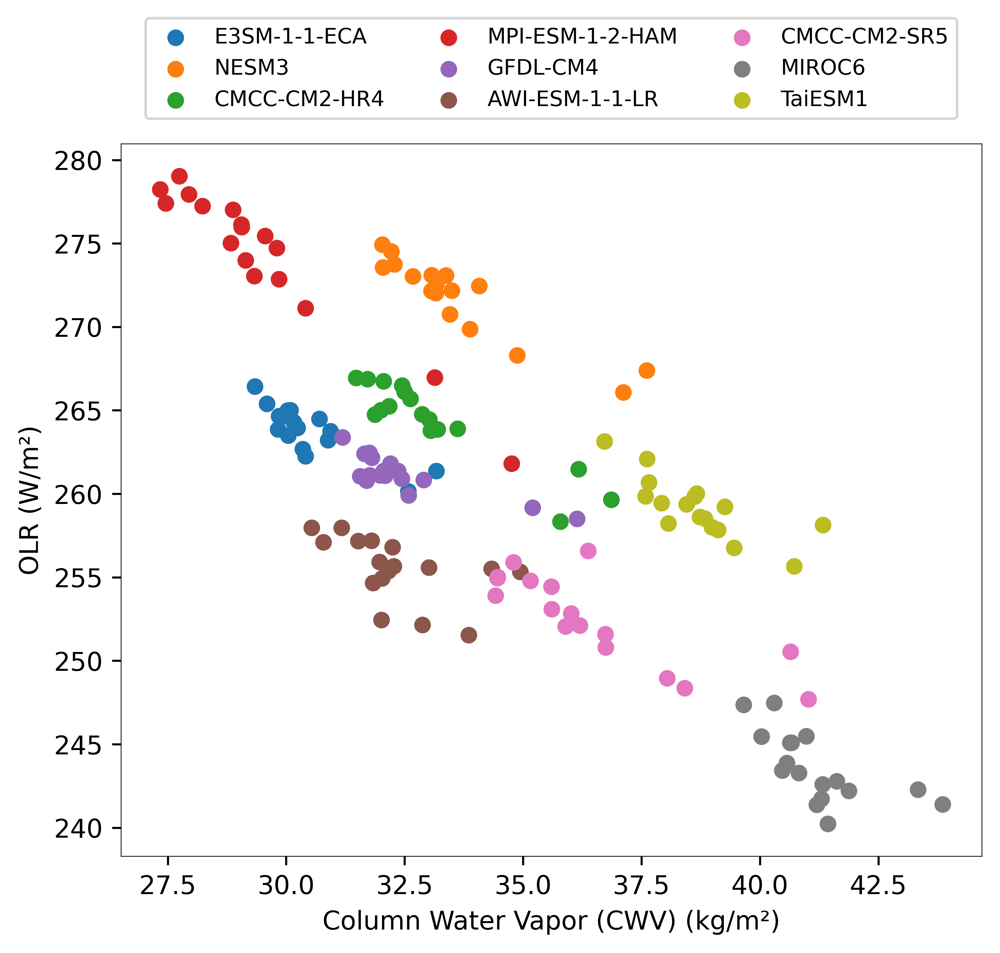

In [ ]:
models = ['E3SM-1-1-ECA',
    'NESM3',
    'CMCC-CM2-HR4',
    'MPI-ESM-1-2-HAM',
    'GFDL-CM4',
    'AWI-ESM-1-1-LR',
    'CMCC-CM2-SR5',
    'MIROC6',
    'TaiESM1']
plt.rcParams['figure.figsize'] = [6,5]
for i in range(len(models)):
  df_sel = df_ta.query('source_id == '+'"'+models[i]+'"')
  zstores = df_sel.zstore.values
  mappers = [gcs.get_mapper(zstore) for zstore in zstores]
  ds_list = []
  for mapper in mappers:
    ds_list.append(xr.open_zarr(mapper, consolidated=True))

  ds = xr.merge(ds_list, compat='override')
  ds.coords['lon'] = (ds.coords['lon']+180) % 360 -180
  ds2 = ds.sortby(ds.lon)
  ds3 = ds2.sel(lat=slice(lat1,lat2), lon=slice(lon1,lon2))

  lon_grid, lat_grid = np.meshgrid(ds3.lon, ds3.lat)
  mask = globe.is_land(lat_grid, lon_grid)

  jjas = ds3.time.dt.month.isin(range(6, 10))
  ds4 = ds3.sel(time=jjas)
  ds5 = ds4.resample(time="10YS").mean()
  ds6 = ds5.where(mask>0).mean(dim=['lat','lon'])

  #plt.scatter(ds6.prw, ds6.rlut, label=models[i], s=40)
  plt.scatter(ds6.prw, ds6.rlut, label=models[i], s=30)
  plt.ylabel('OLR (W/m\u00b2)')
  plt.xlabel('Column Water Vapor (CWV) (kg/m\u00b2)')
  plt.legend(ncols=3,
              loc='lower center', bbox_to_anchor=(0.5, 1.02), fontsize='small')
  print(models[i]+' done')

MPI-ESM-1-2-HAM loaded
MIROC6 loaded
CMCC-CM2-SR5 loaded
TaiESM1 loaded
Qcont =  [27.706635   8.869152  17.878836   2.4394429]
Tcont =  [72.29338  91.13082  82.12118  97.560555]
TaiESM1 done, time taken: 11.53331184387207
MPI-ESM-1-2-HAM loaded
MIROC6 loaded
CMCC-CM2-SR5 loaded
TaiESM1 loaded
Qcont =  [48.34368    5.9022436 10.130866  16.667953 ]
Tcont =  [51.656322 94.09775  89.86913  83.332054]
TaiESM1 done, time taken: 8.680391550064087


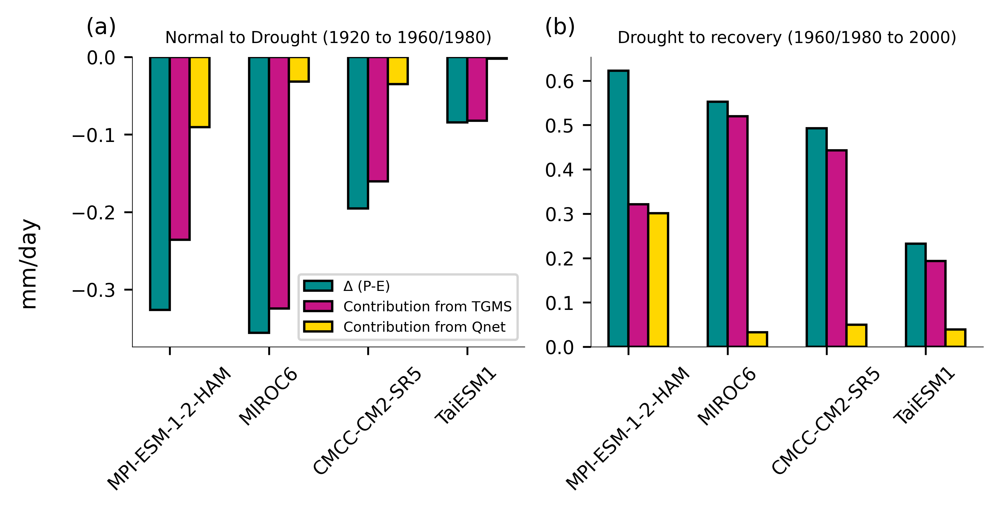

In [ ]:
X = np.arange(1850, 2020, 10)
plt.rcParams['figure.figsize'] = [6,3]
fig, axes = plt.subplot_mosaic([['(a)','(b)']])
labels = ['(a)', '(b)']

for j in range(len(labels)):
  Pref=[]
  Plow=[]
  Qref=[]
  Qlow=[]
  for i in models:
    start = time.time()
    df_sel = df_ta.query('source_id == '+'"'+i+'"')
    zstores = df_sel.zstore.values
    mappers = [gcs.get_mapper(zstore) for zstore in zstores]
    ds_list = []
    for mapper in mappers:
      ds_list.append(xr.open_zarr(mapper, consolidated=True))

    ds = xr.merge(ds_list, compat='override')
    print(i +' loaded')
    ds.coords['lon'] = (ds.coords['lon']+180) % 360 -180
    ds2 = ds.sortby(ds.lon)
    ds3 = ds2.sel(lat=slice(lat1,lat2), lon=slice(lon1,lon2))

    lon_grid, lat_grid = np.meshgrid(ds3.lon, ds3.lat)
    mask = globe.is_land(lat_grid, lon_grid)

    jjas = ds3.time.dt.month.isin(range(6, 10))
    ds4 = ds3.sel(time=jjas)
    ds5 = ds4.resample(time="10YS").mean()
    ds6 = ds5.where(mask>0).mean(dim=['lat','lon']).squeeze()
    PE = 86400*(ds6.pr-ds6.evspsbl)
    Qnet = (ds6.rsdt-ds6.rsut-ds6.rlut)/28.96

    if i=='CMCC-CM2-SR5':
      a=13
    else:
      a=11 # for recovery from drought (1960)

    if j==0:
      b=7 # for 1920
    else:
      b=-2 # for 2000-2010
    Pref.append(np.array(PE[a]))
    Qref.append(np.array(Qnet[a]))
    Plow.append(np.array(PE[b]))
    Qlow.append(np.array(Qnet[b]))



  Q=Qref
  P=Pref
  G=np.divide(Q,P)
  Glow =  np.divide(Qlow, Plow)

  dQ = np.subtract(Qlow,Qref)
  dG = np.subtract(Glow,G)

  dP = []
  Qcont = []
  Tcont = []
  for k in range(len(Plow)):
    Qcont.append((dQ[k]*P[k]/Q[k])/(1+(dG[k]/G[k])))
    Tcont.append((-dG[k]*P[k]/G[k])/(1+(dG[k]/G[k])))
    dP.append(Plow[k]-Pref[k])

  if b==7:
    # run this for Drought diagnostics
    ar1=np.array(dP)
    ar2=np.array(Tcont)
    ar3=np.array(Qcont)
    dP=-1*ar1
    Tcont=-1*ar2
    Qcont=-1*ar3

  ind = np.arange(1,5,1) # the x locations for the groups
  width = 0.2     # the width of the bars

  axes[labels[j]].bar(ind-width/2, dP, width, color='darkcyan', edgecolor='black')
  axes[labels[j]].bar(ind+width/2, Tcont, width, bottom=0, color='mediumvioletred', edgecolor='black')
  axes[labels[j]].bar(ind+3*width/2, Qcont, width, color='gold', bottom=0, edgecolor='black')
  #axes[labels[j]].bar(ind+width/2, np.divide(Tcont, dP)*100, width, color='mediumvioletred', edgecolor='black')
  #axes[labels[j]].bar(ind+3*width/2, np.divide(Qcont, dP)*100, width, color='gold', bottom=0, edgecolor='black')
  axes[labels[j]].set_xticks(ind, models, rotation=45)        #shows all the x labels
  #axes[labels[j]].set_ylim(0,100)
  #axes[labels[j]].grid(ls="dashed", lw=0.3, dashes=(10,10))
  Titles = ['Normal to Drought (1920 to 1960/1980)', 'Drought to recovery (1960/1980 to 2000)']
  axes[labels[j]].set_title(Titles[j], fontsize=7)
  print('Qcont = ', np.divide(Qcont, dP)*100)
  print('Tcont = ', np.divide(Tcont, dP)*100)


  end = time.time()
  print(i +' done, time taken:', end-start)


axes[labels[0]].legend(['\u0394 (P-E)', 'Contribution from TGMS', 'Contribution from Qnet'], fontsize=6)
fig.supylabel('mm/day')
#fig.supylabel('% contribution')
#plt.legend(['\u0394 (P-E)', 'Contribution from TGMS', 'Contribution from Qnet'])
#plt.legend(['Contribution from TGMS', 'Contribution from Qnet'])
plt.tight_layout()

import matplotlib.transforms as mtransforms
for label, ax in axes.items():
    # label physical distance to the left and up:
    trans = mtransforms.ScaledTranslation(-20/72, 10/72, fig.dpi_scale_trans)
    plt.text(0.0, 1.0, label, transform=ax.transAxes + trans, fontsize='large')

plt.show()

MPI-ESM-1-2-HAM loaded
MIROC6 loaded
CMCC-CM2-SR5 loaded
TaiESM1 loaded
Qcont =  [27.706635   8.869152  17.878836   2.4394429]
Tcont =  [72.29338  91.13082  82.12118  97.560555]
TaiESM1 done, time taken: 11.53331184387207
MPI-ESM-1-2-HAM loaded
MIROC6 loaded
CMCC-CM2-SR5 loaded
TaiESM1 loaded
Qcont =  [48.34368    5.9022436 10.130866  16.667953 ]
Tcont =  [51.656322 94.09775  89.86913  83.332054]
TaiESM1 done, time taken: 8.680391550064087


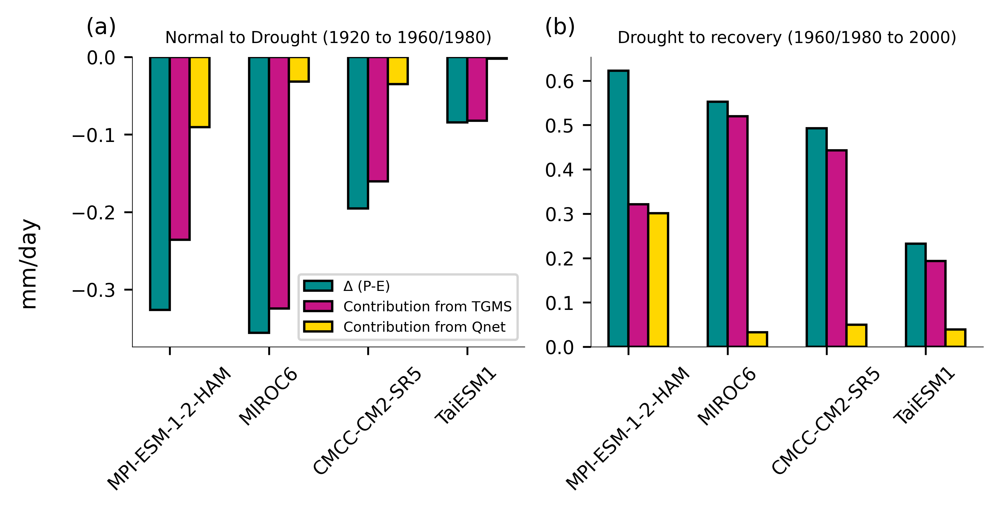

In [ ]:
X = np.arange(1850, 2020, 10)
plt.rcParams['figure.figsize'] = [6,3]
fig, axes = plt.subplot_mosaic([['(a)','(b)']])
labels = ['(a)', '(b)']

for j in range(len(labels)):
  Pref=[]
  Plow=[]
  Qref=[]
  Qlow=[]
  for i in models:
    start = time.time()
    df_sel = df_ta.query('source_id == '+'"'+i+'"')
    zstores = df_sel.zstore.values
    mappers = [gcs.get_mapper(zstore) for zstore in zstores]
    ds_list = []
    for mapper in mappers:
      ds_list.append(xr.open_zarr(mapper, consolidated=True))

    ds = xr.merge(ds_list, compat='override')
    print(i +' loaded')
    ds.coords['lon'] = (ds.coords['lon']+180) % 360 -180
    ds2 = ds.sortby(ds.lon)
    ds3 = ds2.sel(lat=slice(lat1,lat2), lon=slice(lon1,lon2))

    lon_grid, lat_grid = np.meshgrid(ds3.lon, ds3.lat)
    mask = globe.is_land(lat_grid, lon_grid)

    jjas = ds3.time.dt.month.isin(range(6, 10))
    ds4 = ds3.sel(time=jjas)
    ds5 = ds4.resample(time="10YS").mean()
    ds6 = ds5.where(mask>0).mean(dim=['lat','lon']).squeeze()
    PE = 86400*(ds6.pr-ds6.evspsbl)
    Qnet = (ds6.rsdt-ds6.rsut-ds6.rlut)/28.96

    if i=='CMCC-CM2-SR5':
      a=13
    else:
      a=11 # for recovery from drought (1960)

    if j==0:
      b=7 # for 1920
    else:
      b=-2 # for 2000-2010
    Pref.append(np.array(PE[a]))
    Qref.append(np.array(Qnet[a]))
    Plow.append(np.array(PE[b]))
    Qlow.append(np.array(Qnet[b]))



  Q=Qref
  P=Pref
  G=np.divide(Q,P)
  Glow =  np.divide(Qlow, Plow)

  dQ = np.subtract(Qlow,Qref)
  dG = np.subtract(Glow,G)

  dP = []
  Qcont = []
  Tcont = []
  for k in range(len(Plow)):
    Qcont.append((dQ[k]*P[k]/Q[k])/(1+(dG[k]/G[k])))
    Tcont.append((-dG[k]*P[k]/G[k])/(1+(dG[k]/G[k])))
    dP.append(Plow[k]-Pref[k])

  if b==7:
    # run this for Drought diagnostics
    ar1=np.array(dP)
    ar2=np.array(Tcont)
    ar3=np.array(Qcont)
    dP=-1*ar1
    Tcont=-1*ar2
    Qcont=-1*ar3

  ind = np.arange(1,5,1) # the x locations for the groups
  width = 0.2     # the width of the bars

  axes[labels[j]].bar(ind-width/2, dP, width, color='darkcyan', edgecolor='black')
  axes[labels[j]].bar(ind+width/2, Tcont, width, bottom=0, color='mediumvioletred', edgecolor='black')
  axes[labels[j]].bar(ind+3*width/2, Qcont, width, color='gold', bottom=0, edgecolor='black')
  #axes[labels[j]].bar(ind+width/2, np.divide(Tcont, dP)*100, width, color='mediumvioletred', edgecolor='black')
  #axes[labels[j]].bar(ind+3*width/2, np.divide(Qcont, dP)*100, width, color='gold', bottom=0, edgecolor='black')
  axes[labels[j]].set_xticks(ind, models, rotation=45)        #shows all the x labels
  #axes[labels[j]].set_ylim(0,100)
  #axes[labels[j]].grid(ls="dashed", lw=0.3, dashes=(10,10))
  Titles = ['Normal to Drought (1920 to 1960/1980)', 'Drought to recovery (1960/1980 to 2000)']
  axes[labels[j]].set_title(Titles[j], fontsize=7)
  print('Qcont = ', np.divide(Qcont, dP)*100)
  print('Tcont = ', np.divide(Tcont, dP)*100)


  end = time.time()
  print(i +' done, time taken:', end-start)


axes[labels[0]].legend(['\u0394 (P-E)', 'Contribution from TGMS', 'Contribution from Qnet'], fontsize=6)
fig.supylabel('mm/day')
#fig.supylabel('% contribution')
#plt.legend(['\u0394 (P-E)', 'Contribution from TGMS', 'Contribution from Qnet'])
#plt.legend(['Contribution from TGMS', 'Contribution from Qnet'])
plt.tight_layout()

import matplotlib.transforms as mtransforms
for label, ax in axes.items():
    # label physical distance to the left and up:
    trans = mtransforms.ScaledTranslation(-20/72, 10/72, fig.dpi_scale_trans)
    plt.text(0.0, 1.0, label, transform=ax.transAxes + trans, fontsize='large')

plt.show()

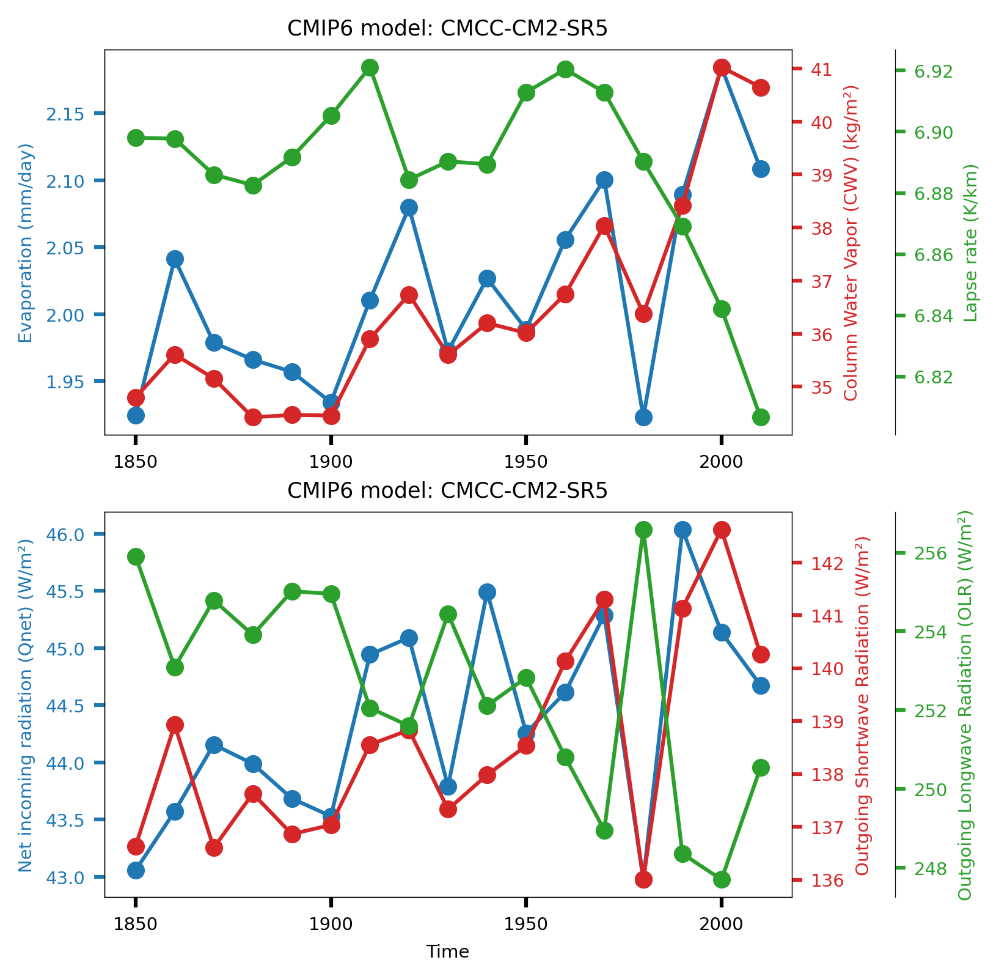

In [ ]:
plt.rcParams.update({'font.size': 7})
fig, (ax0, ax1) = plt.subplots(2, figsize=(6,6), sharex=False)
fig.subplots_adjust(right=0.75)

twin1 = ax0.twinx()
twin2 = ax0.twinx()
# Offset the right spine of twin2.  The ticks and label have already been
# placed on the right by twinx above.
twin2.spines.right.set_position(("axes", 1.15))

p1, = E.plot(ax=ax0, c='tab:blue', label='Evaporation', solid_capstyle='round', marker='o')
p2, = Pwat.plot(ax=twin1, c='tab:red', label='CWV', solid_capstyle='round', marker='o')
p3, = twin2.plot(Pwat.time, Mpigamma, c='tab:green', label='Lapse rate', solid_capstyle='round', marker='o') #Change gamma array here for each model

ax0.set_xlabel(" ")
ax0.set_ylabel("Evaporation (mm/day)")
twin1.set_ylabel("Column Water Vapor (CWV) (kg/m\u00b2)")
twin2.set_ylabel("Lapse rate (K/km)")

ax0.yaxis.label.set_color(p1.get_color())
twin1.yaxis.label.set_color(p2.get_color())
twin2.yaxis.label.set_color(p3.get_color())

tkw = dict(size=4, width=1.5)
ax0.tick_params(axis='y', colors=p1.get_color(), **tkw)
twin1.tick_params(axis='y', colors=p2.get_color(), **tkw)
twin2.tick_params(axis='y', colors=p3.get_color(), **tkw)
ax0.tick_params(axis='x', **tkw)

#ax0.legend(handles=[p1, p2, p3])
ax0.set_title('CMIP6 model: '+mod)

twin3 = ax1.twinx()
twin4 = ax1.twinx()
twin4.spines.right.set_position(("axes", 1.15))

p1, = Qnet.plot(ax=ax1, c='tab:blue', label='Qnet', solid_capstyle='round', marker='o')
p2, = twin3.plot(Pwat.time, ds6.rsut, c='tab:red', label='Shortwave', solid_capstyle='round', marker='o')
p3, = twin4.plot(Pwat.time, ds6.rlut, c='tab:green', label='OLR', solid_capstyle='round', marker='o')

ax1.set_xlabel("Time")
ax1.set_ylabel("Net incoming radiation (Qnet) (W/m\u00b2)")
twin3.set_ylabel("Outgoing Shortwave Radiation (W/m\u00b2)")
twin4.set_ylabel("Outgoing Longwave Radiation (OLR) (W/m\u00b2)")

ax1.yaxis.label.set_color(p1.get_color())
twin3.yaxis.label.set_color(p2.get_color())
twin4.yaxis.label.set_color(p3.get_color())

tkw = dict(size=4, width=1.5)
ax1.tick_params(axis='y', colors=p1.get_color(), **tkw)
twin3.tick_params(axis='y', colors=p2.get_color(), **tkw)
twin4.tick_params(axis='y', colors=p3.get_color(), **tkw)
ax1.tick_params(axis='x', **tkw)
ax1.set_title('CMIP6 model: '+mod )

#ax1.legend(handles=[p1, p2, p3])
plt.show()

# Qnet vs OLR

In [ ]:
models = ['MPI-ESM-1-2-HAM', 'TaiESM1', 'E3SM-1-1', 'CMCC-CM2-SR5']

In [ ]:
#models that have all required variables
models = ['ACCESS-CM2', 'ACCESS-ESM1-5', 'AWI-CM-1-1-MR', 'AWI-ESM-1-1-LR',
       'BCC-CSM2-MR', 'BCC-ESM1', 'CAS-ESM2-0', 'CESM2', 'CESM2-FV2',
       'CESM2-WACCM', 'CESM2-WACCM-FV2', 'CMCC-CM2-HR4', 'CMCC-CM2-SR5',
       'CMCC-ESM2', 'CanESM5', 'E3SM-1-1', 'E3SM-1-1-ECA', 'FGOALS-g3',
       'GFDL-CM4', 'GFDL-ESM4', 'GISS-E2-1-G', 'GISS-E2-1-G-CC',
       'GISS-E2-1-H', 'INM-CM4-8', 'IPSL-CM6A-LR', 'KACE-1-0-G', 'MIROC6',
       'MPI-ESM-1-2-HAM', 'MPI-ESM1-2-HR', 'MPI-ESM1-2-LR', 'MRI-ESM2-0',
       'NESM3', 'NorESM2-MM', 'SAM0-UNICON', 'TaiESM1']
print('Number of models = ', len(models))

Number of models =  35


ACCESS-CM2 loaded
ACCESS-ESM1-5 loaded
AWI-CM-1-1-MR loaded
AWI-ESM-1-1-LR loaded
BCC-CSM2-MR loaded
BCC-ESM1 loaded
CAS-ESM2-0 loaded
CESM2 loaded
CESM2-FV2 loaded
CESM2-WACCM loaded
CESM2-WACCM-FV2 loaded
CMCC-CM2-HR4 loaded
CMCC-CM2-SR5 loaded
CMCC-ESM2 loaded
CanESM5 loaded
E3SM-1-1 loaded
E3SM-1-1-ECA loaded
FGOALS-g3 loaded
GFDL-CM4 loaded
GFDL-ESM4 loaded
GISS-E2-1-G loaded
GISS-E2-1-G-CC loaded
GISS-E2-1-H loaded
INM-CM4-8 loaded
IPSL-CM6A-LR loaded
KACE-1-0-G loaded
MIROC6 loaded
MPI-ESM-1-2-HAM loaded
MPI-ESM1-2-HR loaded
MPI-ESM1-2-LR loaded
MRI-ESM2-0 loaded
NESM3 loaded
NorESM2-MM loaded
SAM0-UNICON loaded
TaiESM1 loaded


Text(0.5, 1.0, 'Sahel, JJAS mean 1990-2014')

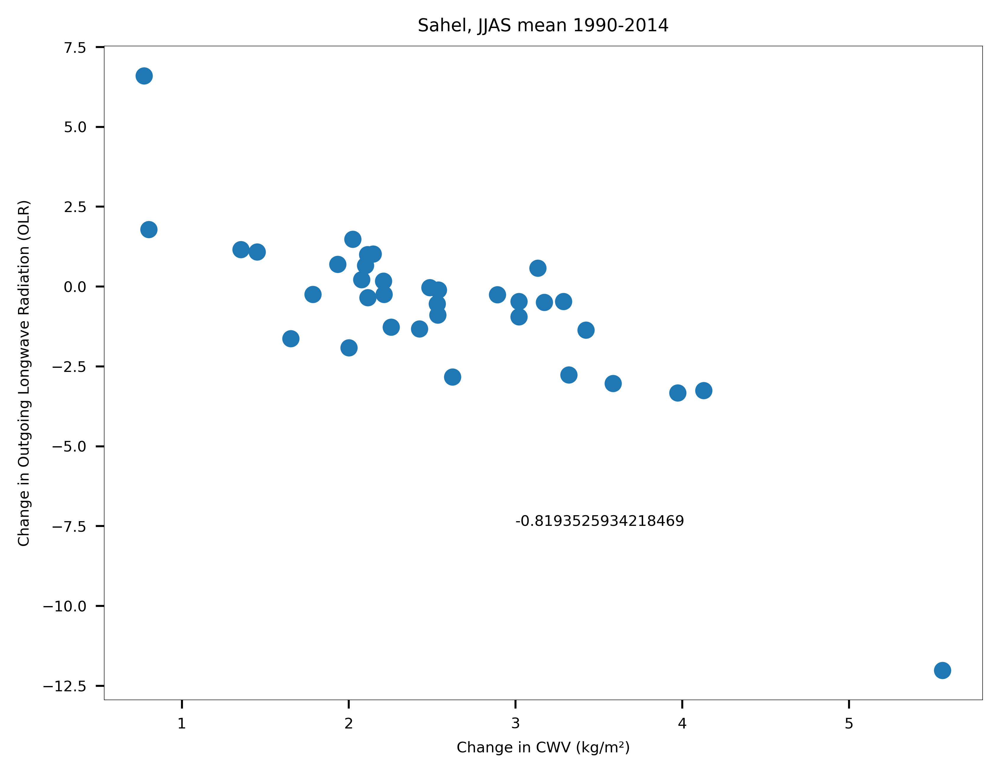

In [ ]:
Pwatlist = []
OLRlist = []
for i in models:
    start = time.time()
    df_sel = df_ta.query('source_id == '+'"'+i+'"')
    zstores = df_sel.zstore.values
    mappers = [gcs.get_mapper(zstore) for zstore in zstores]
    ds_list = []
    for mapper in mappers:
      ds_list.append(xr.open_zarr(mapper, consolidated=True))

    ds = xr.merge(ds_list, compat='override')
    print(i +' loaded')
    ds.coords['lon'] = (ds.coords['lon']+180) % 360 -180
    ds2 = ds.sortby(ds.lon)
    ds3 = ds2.sel(time = slice('1990', '2014'), lat=slice(lat1,lat2), lon=slice(lon1,lon2))

    lon_grid, lat_grid = np.meshgrid(ds3.lon, ds3.lat)
    mask = globe.is_land(lat_grid, lon_grid)

    jjas = ds3.time.dt.month.isin(range(6, 10))
    ds4 = ds3.sel(time=jjas)
    p1 = ds4.sel(time=slice('1990', '1995')).mean(dim=['lat','lon', 'time'])
    p2 = ds4.sel(time=slice('2009', '2014')).mean(dim=['lat','lon', 'time'])
    #ds6 = ds5.where(mask>0).mean(dim=['lat','lon']).squeeze()
    Pwat = p2.prw-p1.prw
    OLR = p2.rlut-p1.rlut

    Pwatlist.append(Pwat)
    OLRlist.append(OLR)

    #plt.scatter(Pwat, OLR, label=i)
    #plt.legend()



In [ ]:
Pwatlist = np.array([2.1137276, 3.135378 , 2.2085342, 2.5311584, 2.1157207, 2.5337868,
       2.1007423, 3.320963 , 3.1742744, 2.2130547, 2.2552547, 1.7865295,
       3.0215492, 0.7736778, 4.1284103, 2.62331  , 2.5375977, 2.0019245,
       3.2882347, 1.9354668, 2.8915367, 2.424652 , 2.0774803, 1.3535767,
       2.1466064, 3.97373  , 2.0243301, 5.56143  , 2.4869156, 1.4512978,
       0.8029556, 3.4230728, 1.6535187, 3.5852623, 3.0207481])

In [ ]:
OLRlist = np.array([  0.99819946,   0.57522583,   0.16882324,  -0.5455017 ,
        -0.34796143,  -0.89489746,   0.6595764 ,  -2.7671204 ,
        -0.49926758,  -0.25213623,  -1.2712708 ,  -0.25128174,
        -0.47198486,   6.598984  ,  -3.2563477 ,  -2.8301697 ,
        -0.11151123,  -1.9182129 ,  -0.46609497,   0.69158936,
        -0.25804138,  -1.3281555 ,   0.21435547,   1.1582336 ,
         1.0205383 ,  -3.3275146 ,   1.4766388 , -12.0164795 ,
        -0.03405762,   1.0861206 ,   1.7798462 ,  -1.3666687 ,
        -1.6365051 ,  -3.0356598 ,  -0.9470215 ])

Text(0.5, 1.0, ' ')

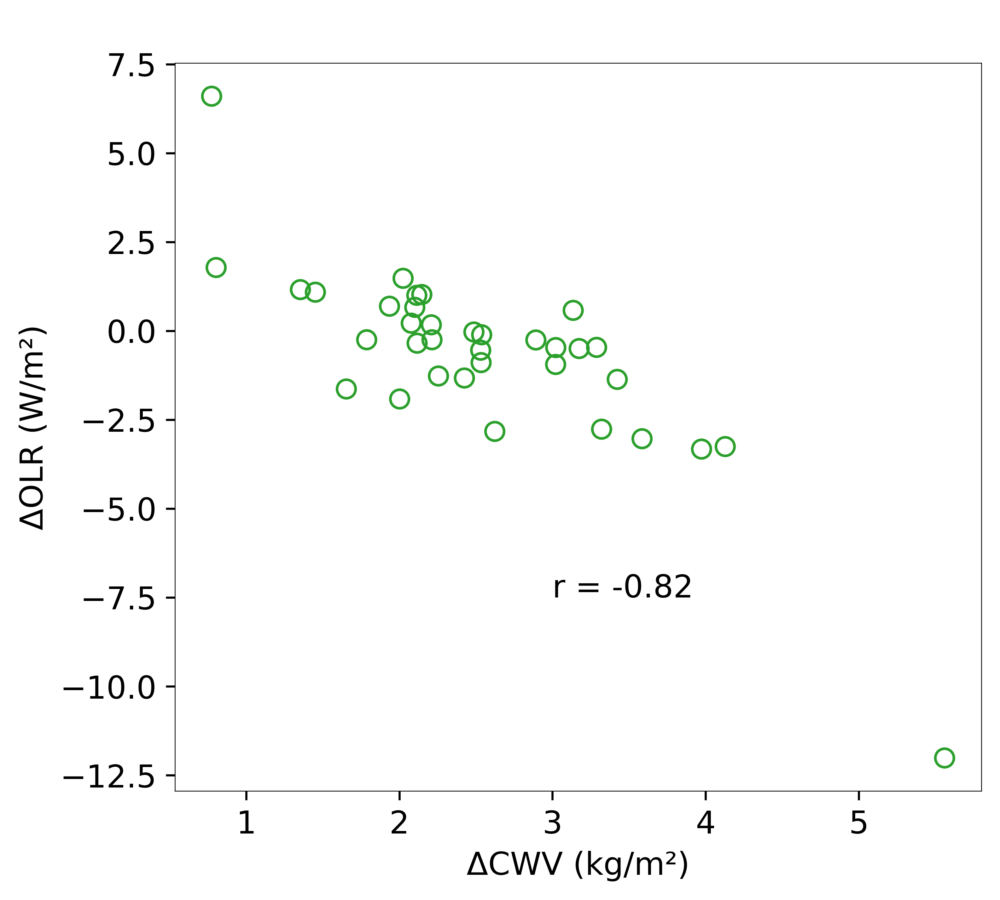

In [ ]:
plt.rcParams['figure.figsize'] = [5.5,5]
plt.scatter(Pwatlist, OLRlist, edgecolor='tab:green', facecolor='none', s=50)
plt.text(3, -7.5, 'r = -0.82')
plt.ylabel('\u0394OLR (W/m\u00b2)')
plt.xlabel('\u0394CWV (kg/m\u00b2)')
plt.title(' ')

# All models variability

In [ ]:
#arranging order of precipitation
models = ['FGOALS-g3',
    'MPI-ESM1-2-HR',
    'CAS-ESM2-0',
    'CanESM5',
    'MPI-ESM1-2-LR',
    'BCC-CSM2-MR',
    'INM-CM4-8',
    'AWI-CM-1-1-MR',
    'KACE-1-0-G',
    'MRI-ESM2-0',
    'CESM2-FV2',
    'IPSL-CM6A-LR',
    'CESM2',
    'CESM2-WACCM-FV2',
    'CESM2-WACCM',
    'TaiESM1',
    'E3SM-1-1-ECA',
    'NESM3',
    'CMCC-CM2-HR4',
    'CMCC-ESM2',
    'NorESM2-MM',
    'MPI-ESM-1-2-HAM',
    'GFDL-CM4',
    'AWI-ESM-1-1-LR',
    'CMCC-CM2-SR5',
    'GFDL-ESM4',
    'MIROC6',
    'SAM0-UNICON'
]
print('Number of models = ', len(models))

Number of models =  28


In [ ]:
FGOALS_gamma = np.array([7.15951549, 7.16268726, 7.16725564, 7.1615079, 7.1647149, 7.17758213, 7.16867139, 7.15482697, 7.15952387, 7.14953538, 7.13781559, 7.14259995, 7.14414246, 7.13757133, 7.13049585, 7.11371568, 7.11652159])
MPI_ESM1_2_HR_gamma = np.array([6.95605609, 6.95575016, 6.96330604, 6.95938608, 6.96443153, 6.97685023, 6.95197203, 6.94163053, 6.940782, 6.94935932, 6.94062868, 6.93946888, 6.92901039, 6.90193286, 6.90715707, 6.88075357, 6.87524783])
CAS_ESM2_0_gamma = np.array([6.99755705, 6.99244702, 7.00022219, 6.98920178, 6.98898308, 6.99361443, 7.02513856, 7.0024721, 7.00965197, 7.00161995, 7.01359174, 6.98938843, 6.99382721, 6.9634266, 6.95185488, 6.94569277, 6.94522945])
#BCC_ESM1_gamma = np.array([7.22846261, 7.20721948, 7.21025645, 7.21683241, 7.21265795, 7.22613942, 7.21047318, 7.2171883, 7.19785519, 7.20758839, 7.22035597, 7.20690208, 7.20681706, 7.18706235, 7.19555944, 7.17567085, 7.15895359])
CanESM5_gamma = np.array([6.73629013, 6.7199064, 6.72816414, 6.71660678, 6.72814651, 6.72138525, 6.72285128, 6.70969979, 6.71366608, 6.69395273, 6.70923245, 6.69755026, 6.69522893, 6.67496262, 6.64577303, 6.65417105, 6.59834202])
MPI_ESM1_2_LR_gamma = np.array([6.95997979, 6.95408363, 6.95942752, 6.97424621, 6.96616647, 6.96922077, 6.98227941, 6.95954188, 6.95931307, 6.95066528, 6.94171847, 6.94142864, 6.96187188, 6.93427105, 6.9161493, 6.89850682, 6.91164103])
BCC_CSM2_MR_gamma = np.array([7.13842461, 7.13172653, 7.12528717, 7.13151236, 7.13574763, 7.11829467, 7.10980072, 7.11376361, 7.11836055, 7.10241052, 7.11184289, 7.11239155, 7.11233277, 7.08485368, 7.07050536, 7.05799805, 7.05541055])
INM_CM4_8_gamma = np.array([6.7203666, 6.71451135, 6.69144647, 6.71489187, 6.71279371, 6.70413811, 6.70972233, 6.69350248, 6.69257464, 6.68439278, 6.69305851, 6.70513343, 6.69480461, 6.69893655, 6.69415792, 6.68860846, 6.66659948])
AWI_CM_1_1_MR_gamma = np.array([6.89910358, 6.94634293, 6.94246319, 6.96261312, 6.93794962, 6.95486165, 6.9588976, 6.94049162, 6.96740642, 6.93341161, 6.93434494, 6.94663924, 6.93454208, 6.91056558, 6.87665548, 6.85548568, 6.86022196])
KACE_1_0_G_gamma = np.array([7.11555511, 7.11131283, 7.10487603, 7.1045968, 7.11533007, 7.1257082, 7.11379676, 7.11704962, 7.10262136, 7.09859016, 7.07350879, 7.08616435, 7.08396699, 7.07688572, 7.06033681, 7.03305661, 7.01799011])
MRI_ESM2_0_gamma = np.array([6.91687268, 6.9348922, 6.93389967, 6.92569265, 6.94798747, 6.92564994, 6.93268374, 6.93413267, 6.91511325, 6.91698844, 6.91300885, 6.91269127, 6.91396191, 6.89326701, 6.87917455, 6.86793135, 6.89565325])
CESM2_FV2_gamma = np.array([7.02397238, 6.99984474, 7.01538004, 7.0176546, 7.01146681, 7.02404759, 7.01047246, 7.00817111, 7.02320394, 6.99844729, 7.01565459, 7.00517932, 6.99988389, 6.99870484, 6.97897122, 6.94247074, 6.92322466])
IPSL_CM6A_LR_gamma = np.array([6.84115315, 6.84852423, 6.83436412, 6.8420491, 6.83499509, 6.83821071, 6.84598958, 6.84177595, 6.83730457, 6.82598558, 6.81351303, 6.79381749, 6.79966958, 6.79361913, 6.75122618, 6.74843957, 6.73394715])
CESM2_gamma = np.array([6.91877697, 6.89636277, 6.90781035, 6.92823626, 6.92324068, 6.89587702, 6.91197343, 6.90085889, 6.90890541, 6.91560255, 6.92019505, 6.91666787, 6.90073693, 6.8862746, 6.87369554, 6.85598992, 6.83525137])
CESM2_WACCM_FV2_gamma = np.array([7.0003934, 6.98645368, 6.99596914, 6.98122522, 7.0032086, 6.99981708, 6.98906643, 6.99161735, 6.98722638, 6.98714638, 6.98980117, 6.95816526, 6.97238433, 6.95930181, 6.95948161, 6.91841524, 6.90130817])
CESM2_WACCM_gamma = np.array([6.89900586, 6.90819079, 6.90474955, 6.91346528, 6.92289238, 6.91039845, 6.91576238, 6.90678987, 6.89189192, 6.89578337, 6.89300546, 6.89912614, 6.88033714, 6.87348173, 6.85991092, 6.83088933, 6.82750677])
TaiESM1_gamma = np.array([6.93602193, 6.92865759, 6.93705457, 6.93821658, 6.95140947, 6.95511538, 6.97383025, 6.94672108, 6.94861975, 6.95568347, 6.9670747, 6.95853852, 6.96317824, 6.95456629, 6.95084736, 6.92328787, 6.90004851])
E3SM_1_1_ECA_gamma = np.array([6.53659007, 6.53930952, 6.5152977, 6.53492293, 6.57348493, 6.55705657, 6.55579848, 6.55418974, 6.54928278, 6.55498404, 6.55607441, 6.53588523, 6.53458277, 6.50675377, 6.50726893, 6.48283258, 6.46735894])
NESM3_gamma = np.array([6.94836018, 6.94728526, 6.94268343, 6.96043007, 6.94935329, 6.95722706, 6.95253774, 6.97131368, 6.94557084, 6.94336667, 6.92557088, 6.95000571, 6.94267144, 6.94574583, 6.89635066, 6.8847627, 6.87251348])
CMCC_CM2_HR4_gamma = np.array([6.87247517, 6.8630933, 6.8770047, 6.87501962, 6.88850216, 6.88519314, 6.87983855, 6.88877462, 6.88051744, 6.86815437, 6.86615687, 6.86678121, 6.86528541, 6.85920225, 6.82240759, 6.8217795, 6.80387056])
CMCC_ESM2_gamma = np.array([6.96569009, 6.95063938, 6.96454723, 6.98691766, 6.98526009, 6.97039985, 6.96522185, 6.95866503, 6.94694201, 6.94100976, 6.95544504, 6.92971297, 6.92965487, 6.91653997, 6.89593995, 6.86231779, 6.86665853])
NorESM2_MM_gamma = np.array([6.8068071, 6.7929744, 6.81342487, 6.81180127, 6.7971203, 6.81081371, 6.80311058, 6.80559718, 6.80153023, 6.79030267, 6.80152082, 6.80999278, 6.81596989, 6.81095818, 6.78157442, 6.78132559, 6.77458558])
MPI_ESM_1_2_HAM_gamma = np.array([6.89802134, 6.89775683, 6.88599371, 6.88257317, 6.89166504, 6.90525817, 6.92115157, 6.88437177, 6.89033197, 6.88938272, 6.91290233, 6.92044647, 6.91294876, 6.89024531, 6.86909092, 6.84217242, 6.80662005])
GFDL_CM4_gamma = np.array([6.97993422, 7.00313992, 6.97641304, 6.97167296, 6.98850379, 6.99724321, 6.99033548, 6.97618992, 6.96508334, 6.95684295, 6.9588335, 6.97150855, 6.97494192, 6.97491341, 6.95599062, 6.90597766, 6.89037583])
AWI_ESM_1_1_LR_gamma = np.array([6.93057256, 6.91507888, 6.93162645, 6.9257625, 6.94944628, 6.94274349, 6.93453886, 6.92586627, 6.93128429, 6.93113245, 6.93340152, 6.92576289, 6.9227855, 6.90092123, 6.90414969, 6.88858154, 6.85522632])
CMCC_CM2_SR5_gamma = np.array([6.92632508, 6.92542368, 6.93176995, 6.94090418, 6.93860776, 6.93939802, 6.91647231, 6.89988331, 6.91686709, 6.91180752, 6.91075905, 6.88725728, 6.86747637, 6.89114922, 6.8600696, 6.81017305, 6.82063161])
GFDL_ESM4_gamma = np.array([6.96134195, 6.98478884, 6.97874782, 6.96536473, 6.97502911, 6.9603399, 6.95899512, 6.96567225, 6.95516538, 6.96894925, 6.96541088, 6.95743512, 6.9590634, 6.94200778, 6.91298286, 6.91328158, 6.91009861])
MIROC6_gamma = np.array([7.06497592, 7.06912026, 7.0856483, 7.07003473, 7.06854962, 7.0874706, 7.07729217, 7.06972055, 7.07187497, 7.0627504, 7.07374289, 7.10144261, 7.07119121, 7.0794489, 7.05771605, 7.04047434, 7.03569135])
SAM0_UNICON_gamma = np.array([6.9740684, 6.96149222, 6.96135546, 6.99203242, 6.96325126, 6.98869712, 6.96157025, 6.97294173, 6.9740555, 6.96854969, 6.95736777, 6.95794242, 6.96823412, 6.95774972, 6.95165165, 6.91827045, 6.89360131])

In [ ]:
gammas = [FGOALS_gamma, MPI_ESM1_2_HR_gamma, CAS_ESM2_0_gamma, CanESM5_gamma, MPI_ESM1_2_LR_gamma, BCC_CSM2_MR_gamma, INM_CM4_8_gamma, AWI_CM_1_1_MR_gamma, KACE_1_0_G_gamma, MRI_ESM2_0_gamma, CESM2_FV2_gamma, IPSL_CM6A_LR_gamma, CESM2_gamma, CESM2_WACCM_FV2_gamma, CESM2_WACCM_gamma, TaiESM1_gamma, E3SM_1_1_ECA_gamma, NESM3_gamma, CMCC_CM2_HR4_gamma, CMCC_ESM2_gamma, NorESM2_MM_gamma, MPI_ESM_1_2_HAM_gamma, GFDL_CM4_gamma, AWI_ESM_1_1_LR_gamma, CMCC_CM2_SR5_gamma, GFDL_ESM4_gamma, MIROC6_gamma, SAM0_UNICON_gamma]

[7.55744293 7.55236645 7.55457055 7.55048804 7.54864572 7.57186
 7.55824824 7.53000421 7.53162114 7.52262822 7.50839107 7.5169688
 7.52075792 7.49441957 7.48923723 7.44881722 7.44067944]
[127508.02870651 -14402.09817355   -874.79184278]
FGOALS-g3 done
[7.08434617 7.08712285 7.09102278 7.09366622 7.10212147 7.11278552
 7.07614632 7.07211617 7.06167698 7.06406355 7.04813195 7.06470971
 7.04639661 7.01302121 7.02283966 6.97003109 6.96945329]
[ 2.93046736e+02 -4.70191377e-16 -5.01809790e+00]
MPI-ESM1-2-HR done
[7.22993889 7.22755247 7.24019282 7.21826045 7.22845868 7.2295551
 7.27042136 7.24516105 7.24356756 7.24468805 7.26238779 7.24097673
 7.2440314  7.19751009 7.16558302 7.14518302 7.15062355]
[ 3.09768969e+02 -1.29884032e-17 -5.52022716e+00]
CAS-ESM2-0 done


KeyboardInterrupt: 

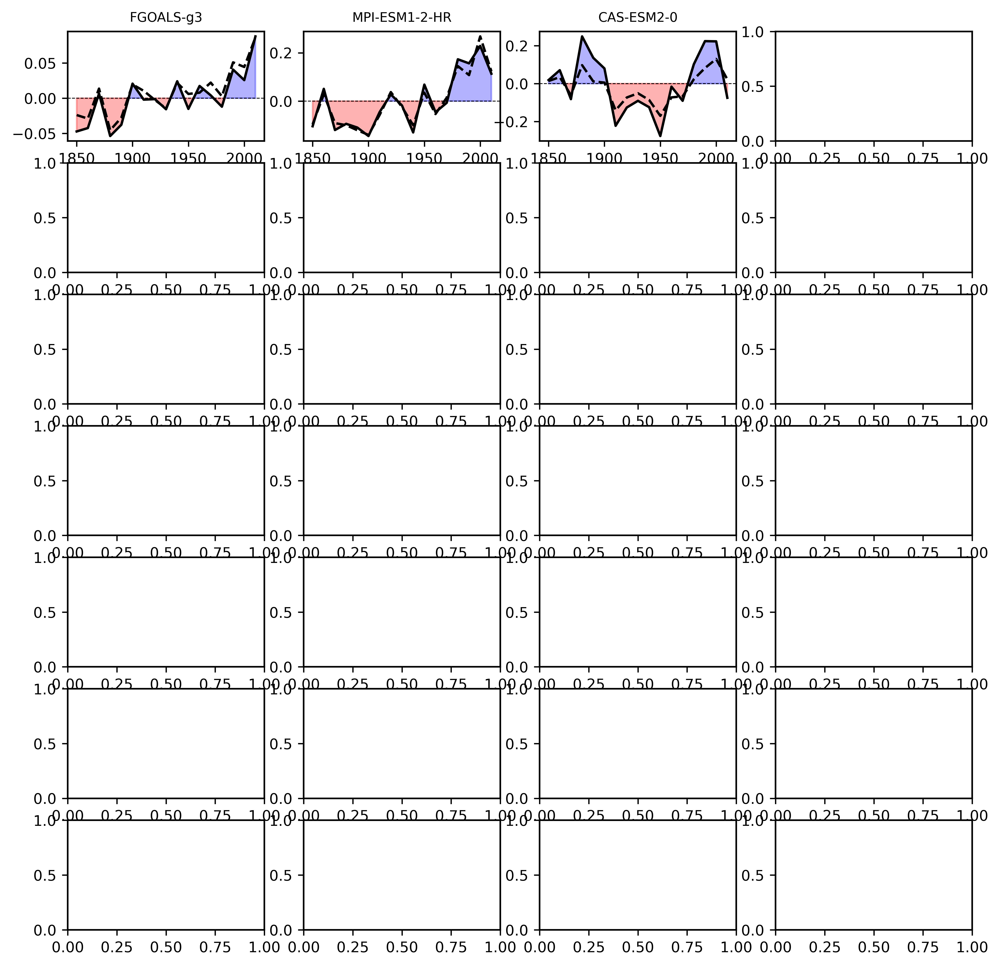

In [ ]:
#Complete code that will run on its own (calculates lapse rate from scratch)
plt.rcParams.update({'font.size': 9})
mpl.rcParams['axes.linewidth'] = 1
fig, axs = plt.subplots(nrows=7,ncols=4,
                        figsize=(10,10))
X = np.arange(1850, 2020, 10)
axs=axs.flatten()

for i in range(len(models)):
    #First get vertical profile data to calculate lapse rate
    df_ta4 = df.query("table_id == 'Amon' & variable_id == ['pr', 'prw', 'rlut', 'rsdt', 'rsut', 'evspsbl', 'zg', 'ta'] & experiment_id == ['historical'] & member_id=='r1i1p1f1' & source_id=="+'"'+models[i]+'"')
    zstores = df_ta4.zstore.values
    mappers = [gcs.get_mapper(zstore) for zstore in zstores]
    dl = xr.open_mfdataset(mappers, engine='zarr', consolidated=True, compat='override')

    dl.coords['lon'] = (dl.coords['lon']+180) % 360 -180
    dl2 = dl.sortby(dl.lon)

    grid1 = dl2.sel(plev=slice(100000,20000), lat=slice(lat1,lat2), lon=slice(lon1,lon2))
    grid2 = grid1.sortby("plev")
    grid3 = grid2.interpolate_na(dim='plev', method="cubic", fill_value="extrapolate") #to fill in missing values in the data

    sel = range(6, 10)
    months = grid3.time.dt.month.isin(sel) #JJAS
    clim = grid3.sel(time=months)
    clim = clim.resample(time='10YS').mean()  # For decadal

    T = clim.ta.mean(dim=['lat', 'lon'])
    z = clim.zg.mean(dim=['lat', 'lon'])
    lapse_rate_values = xr.cov(z, T, dim='plev') / z.var(dim='plev', ddof=1)
    gammalist = 1000*abs(lapse_rate_values.values)
    print(gammalist)

    #Now get surface data and estimate rainfall
    ds6 = clim
    PE = 26.16*86400*(ds6.pr-ds6.evspsbl).mean(dim=['lat','lon'])
    E = 26.16*86400*ds6.evspsbl.mean(dim=['lat','lon'])
    Qnet = (ds6.rsdt-ds6.rsut-ds6.rlut).mean(dim=['lat','lon'])
    Pwat = ds6.prw.mean(dim=['lat','lon'])

    TGMS = Qnet/PE
    rec = 1/Pwat

    def objective(X, a, b, c):
      x,y = X
      return a*x + b*y*x + c

    x1, y1 = rec, gammalist
    lower_bounds = [0, -np.inf, -np.inf]
    upper_bounds = [np.inf, 0, np.inf] # This is the key change
    popt1, _ = curve_fit(objective, (x1, y1), TGMS, bounds=(lower_bounds, upper_bounds))

    a1, b1, c1= popt1
    print(popt1)

    TGMScal = objective((rec, gammalist), a1, b1, c1) #These are calculated TGMS values
    Pcal = []
    for j in range(len(PE)):
        Pcal.append(np.array(Qnet)[j]/TGMScal[j])

    actualp = (PE+E)/26.16
    calculatedp = (np.array(Pcal)+E)/26.16
    y1 = actualp - np.average(actualp)
    y2 = calculatedp - np.average(actualp)

    axs[i].plot(X, y1, color='black', label = 'GCM')
    axs[i].plot(X, y2, c='k', label='Diagnostic model', solid_capstyle='round', linestyle='--')
    axs[i].set_title(models[i], fontsize=8)
    axs[i].axhline(0, color='k', ls='dashed', lw=0.5)
    axs[i].fill_between(X, y1, where=(y1 > 0), color='blue', alpha=.3, interpolate=True)
    axs[i].fill_between(X, y1, where=(y1 < 0), color='red', alpha=.3, interpolate=True)

    print(models[i]+' done')

fig.supxlabel('Time')
fig.supylabel('Precipitation anomaly (mm/day)')
plt.tight_layout()
plt.show()

[ 1.17169058e-13 -1.64773323e+02]
FGOALS-g3 done
[ 1.35535965e+02 -8.90351892e-12]
MPI-ESM1-2-HR done
[ 1.24315219e+02 -6.67461962e-18]
CAS-ESM2-0 done
[ 3.31414068e+03 -2.77928846e-14]
CanESM5 done
[113.85005277  -1.43477052]
MPI-ESM1-2-LR done
[ 8.43101498e+01 -6.69386421e-16]
BCC-CSM2-MR done
[ 3.40421640e+02 -9.79646543e-20]
INM-CM4-8 done
[ 1.10943205e+02 -1.26519617e-16]
AWI-CM-1-1-MR done
[ 1.58551415e+02 -1.67254180e-11]
KACE-1-0-G done
[6380.39394442 -886.95657307]
MRI-ESM2-0 done
[ 4.37116538e+01 -2.20453905e-07]
CESM2-FV2 done
[ 8.59967567e+01 -4.88036561e-23]
IPSL-CM6A-LR done
[ 5.10295113e+01 -1.21238166e-08]
CESM2 done
[89.0284786  -6.42892468]
CESM2-WACCM-FV2 done
[ 5.12901586e+01 -7.98490286e-09]
CESM2-WACCM done
[ 9.88316208e+01 -5.16987883e-26]
TaiESM1 done
[ 8.10217843e+01 -1.40088628e-09]
E3SM-1-1-ECA done
[ 6.69547106e+01 -1.32492878e-11]
NESM3 done
[ 1.23921154e+02 -1.93870456e-26]
CMCC-CM2-HR4 done
[ 1.27248308e+02 -4.03896783e-27]
CMCC-ESM2 done
[ 4.40629178e+01

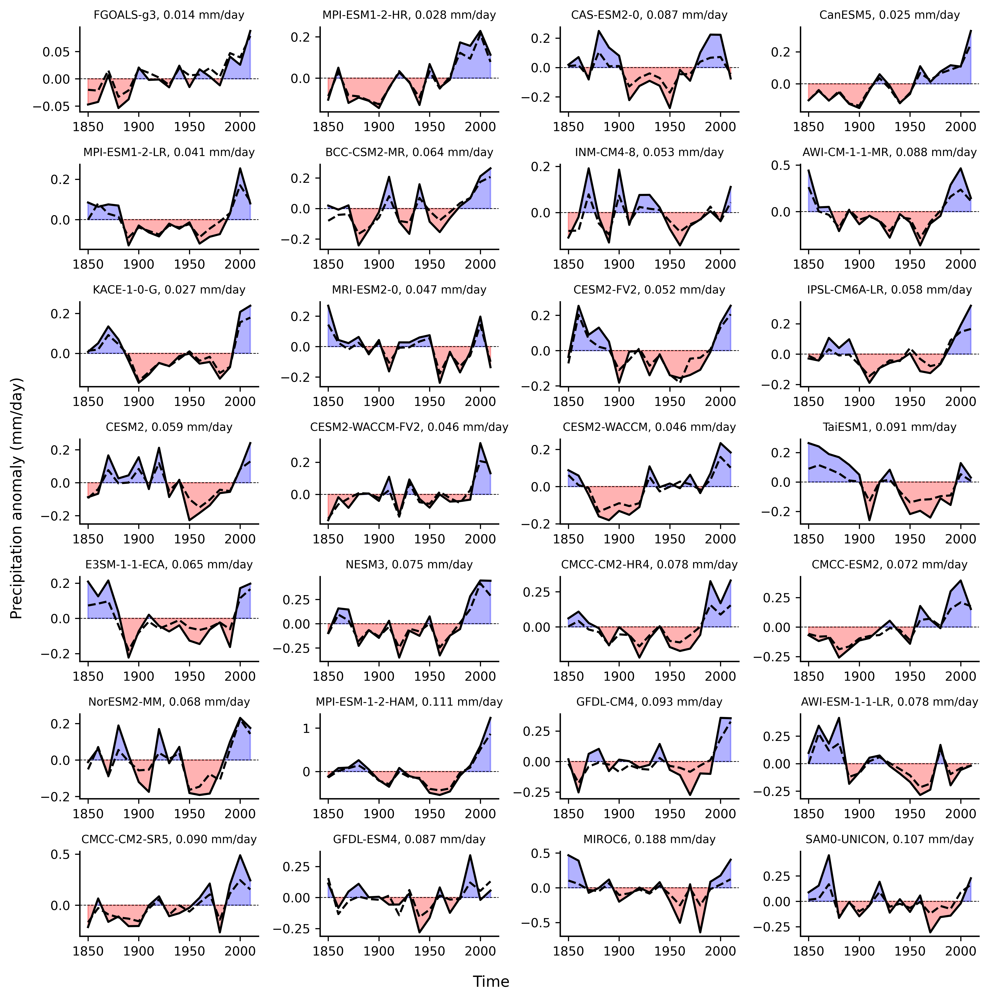

In [ ]:
# Faster code without calculating gamma
plt.rcParams.update({'font.size': 9})
mpl.rcParams['axes.linewidth'] = 1
fig, axs = plt.subplots(nrows=7,ncols=4,
                        figsize=(10,10))
X = np.arange(1850, 2020, 10)
axs=axs.flatten()
rmselist = np.array([])

for i in range(len(models)):
    #First get vertical profile data to calculate lapse rate
    df_ta4 = df.query("table_id == 'Amon' & variable_id == ['pr', 'prw', 'rlut', 'rsdt', 'rsut', 'evspsbl'] & experiment_id == ['historical'] & member_id=='r1i1p1f1' & source_id=="+'"'+models[i]+'"')
    zstores = df_ta4.zstore.values
    mappers = [gcs.get_mapper(zstore) for zstore in zstores]
    dl = xr.open_mfdataset(mappers, engine='zarr', consolidated=True, compat='override')

    dl.coords['lon'] = (dl.coords['lon']+180) % 360 -180
    dl2 = dl.sortby(dl.lon)

    grid1 = dl2.sel(lat=slice(lat1,lat2), lon=slice(lon1,lon2))

    sel = range(6, 10)
    months = grid1.time.dt.month.isin(sel) #JJAS
    clim = grid1.sel(time=months)
    clim = clim.resample(time='10YS').mean()  # For decadal

    gammalist = gammas[i]

    #Now get surface data and estimate rainfall
    ds6 = clim
    PE = 26.16*86400*(ds6.pr-ds6.evspsbl).mean(dim=['lat','lon'])
    E = 26.16*86400*ds6.evspsbl.mean(dim=['lat','lon'])
    Qnet = (ds6.rsdt-ds6.rsut-ds6.rlut).mean(dim=['lat','lon'])
    Pwat = ds6.prw.mean(dim=['lat','lon'])

    TGMS = Qnet/PE
    rec = 1/Pwat

    def objective(X, a, b):
      x,y = X
      return a*x + b*y*x

    x1, y1 = rec, gammalist
    lower_bounds = [0, -np.inf]
    upper_bounds = [np.inf, 0] # This is the key change
    popt1, _ = curve_fit(objective, (x1, y1), TGMS, bounds=(lower_bounds, upper_bounds))

    a1, b1= popt1
    print(popt1)

    TGMScal = objective((rec, gammalist), a1, b1) #These are calculated TGMS values
    Pcal = Qnet/TGMScal

    actualp = (PE+E)/26.16
    calculatedp = (np.array(Pcal)+E)/26.16
    mean = np.average(actualp)
    y1 = actualp - mean
    y2 = calculatedp - mean
    rmse = mean_squared_error(y1,y2)
    rmselist = np.append(rmselist, np.sqrt(rmse))

    axs[i].plot(X, y1, color='black', label = 'GCM')
    axs[i].plot(X, y2, c='k', label='Diagnostic model', solid_capstyle='round', linestyle='--')
    axs[i].set_title(models[i]+', %.3f mm/day' %(rmselist[i]), fontsize=8)
    axs[i].axhline(0, color='k', ls='dashed', lw=0.5)
    axs[i].fill_between(X, y1, where=(y1 > 0), color='blue', alpha=.3, interpolate=True)
    axs[i].fill_between(X, y1, where=(y1 < 0), color='red', alpha=.3, interpolate=True)

    print(models[i]+' done')

fig.supxlabel('Time')
fig.supylabel('Precipitation anomaly (mm/day)')
plt.tight_layout()
plt.show()

In [ ]:
PElist = np.array([])
corrlist = np.array([])
Qnetlist = np.array([])

for i in range(len(models)):
    #First get vertical profile data to calculate lapse rate
    df_ta4 = df.query("table_id == 'Amon' & variable_id == ['pr', 'prw', 'rlut', 'rsdt', 'rsut', 'evspsbl'] & experiment_id == ['historical'] & member_id=='r1i1p1f1' & source_id=="+'"'+models[i]+'"')
    zstores = df_ta4.zstore.values
    mappers = [gcs.get_mapper(zstore) for zstore in zstores]
    dl = xr.open_mfdataset(mappers, engine='zarr', consolidated=True, compat='override')

    dl.coords['lon'] = (dl.coords['lon']+180) % 360 -180
    dl2 = dl.sortby(dl.lon)

    grid1 = dl2.sel(lat=slice(lat1,lat2), lon=slice(lon1,lon2))

    sel = range(6, 10)
    months = grid1.time.dt.month.isin(sel) #JJAS
    clim = grid1.sel(time=months)
    clim = clim.resample(time='10YS').mean()  # For decadal

    gammalist = gammas[i]

    #Now get surface data and estimate rainfall
    ds6 = clim
    PE = 86400*(ds6.pr-ds6.evspsbl).mean(dim=['lat','lon'])
    Qnet = (ds6.rsdt-ds6.rsut-ds6.rlut).mean(dim=['lat','lon'])
    Pwat = ds6.prw.mean(dim=['lat','lon'])

    TGMS = Qnet/PE
    corrlist = np.append(corrlist, (abs(np.corrcoef(TGMS, Pwat)[0,1])+abs(np.corrcoef(TGMS, gammalist)[0,1]))/2)
    mean = np.average(PE)
    PElist = np.append(PElist, mean)
    #Qnetlist = np.append(Qnetlist, np.average(Qnet))
    print(models[i]+' done')

FGOALS-g3 done
MPI-ESM1-2-HR done
CAS-ESM2-0 done
CanESM5 done
MPI-ESM1-2-LR done
BCC-CSM2-MR done
INM-CM4-8 done
AWI-CM-1-1-MR done
KACE-1-0-G done
MRI-ESM2-0 done
CESM2-FV2 done
IPSL-CM6A-LR done
CESM2 done
CESM2-WACCM-FV2 done
CESM2-WACCM done
TaiESM1 done
E3SM-1-1-ECA done
NESM3 done
CMCC-CM2-HR4 done
CMCC-ESM2 done
NorESM2-MM done
MPI-ESM-1-2-HAM done
GFDL-CM4 done
AWI-ESM-1-1-LR done
CMCC-CM2-SR5 done
GFDL-ESM4 done
MIROC6 done
SAM0-UNICON done


In [ ]:
np.delete(models, [-1,-3,-5])

array(['FGOALS-g3', 'MPI-ESM1-2-HR', 'CAS-ESM2-0', 'CanESM5',
       'MPI-ESM1-2-LR', 'BCC-CSM2-MR', 'INM-CM4-8', 'AWI-CM-1-1-MR',
       'KACE-1-0-G', 'MRI-ESM2-0', 'CESM2-FV2', 'IPSL-CM6A-LR', 'CESM2',
       'CESM2-WACCM-FV2', 'CESM2-WACCM', 'TaiESM1', 'E3SM-1-1-ECA',
       'NESM3', 'CMCC-CM2-HR4', 'CMCC-ESM2', 'NorESM2-MM',
       'MPI-ESM-1-2-HAM', 'GFDL-CM4', 'CMCC-CM2-SR5', 'MIROC6'],
      dtype='<U15')

In [ ]:
X = np.delete(PElist, [-1,-3,-5]).reshape(-1, 1)
y = np.delete(corrlist, [-1,-3,-5]).reshape(-1, 1)

# Splitting the data into training and testing data
regr = LinearRegression()

regr.fit(X, y)
y_pred = regr.predict(X)

0.25751292520032765


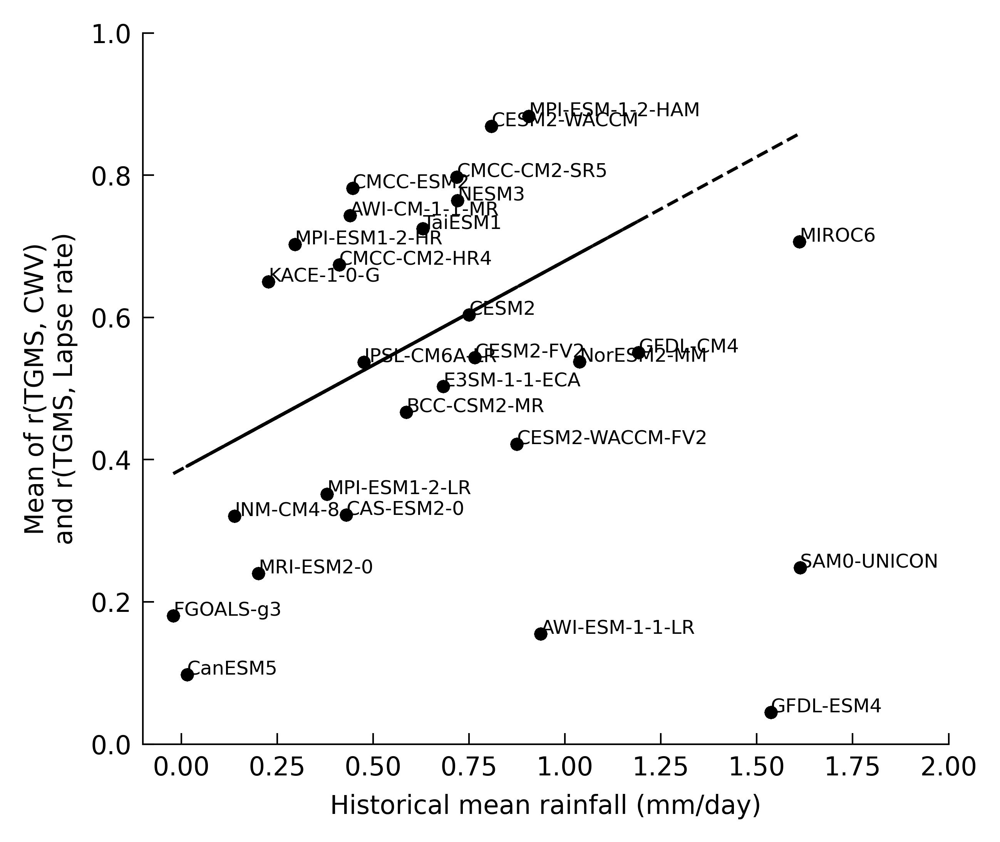

In [ ]:
fig, axs = plt.subplots(nrows=1,ncols=1,
                        figsize=(4.5,4))
axs.spines[['right', 'top']].set_visible(False)
axs.tick_params(axis="both",direction="in", left="off",labelleft="on", width=0.5)
axs.set_ylim([0, 1])
axs.set_xlim([-0.1, 2])

texts = []
for i, txt in enumerate(models):
    t = axs.annotate(txt, (PElist[i], corrlist[i]), fontsize=6)
    plt.scatter(PElist, corrlist, marker='.', color='k')

plt.plot(np.delete(PElist, [-1,-3,-5]), y_pred, color='k', linewidth=1, linestyle='--')
plt.xlabel('Historical mean rainfall (mm/day)', fontsize=8)
plt.ylabel('Mean of r(TGMS, CWV)\nand r(TGMS, Lapse rate)', fontsize=8)
plt.show()

# New contribution

In [ ]:
Taigamma = np.array([6.9360204, 6.9286575, 6.937054 , 6.938216 , 6.9514093, 6.9551153,
       6.973829 , 6.9467216, 6.948621 , 6.9556837, 6.967073 , 6.958537 ,
       6.963178 , 6.9545665, 6.9508476, 6.9232855, 6.9000487])
Mpigamma = np.array([6.8980217, 6.89776  , 6.885998 , 6.8825727, 6.8916655, 6.9052567,
       6.9211516, 6.8843694, 6.8903313, 6.889381 , 6.912904 , 6.920447 ,
       6.9129477, 6.890246 , 6.8690896, 6.842173 , 6.806621 ])
Mirocgamma = np.array([7.07219, 7.07698, 7.0928 , 7.07584, 7.07585, 7.09451, 7.08565,
       7.07659, 7.07944, 7.07024, 7.08143, 7.1089 , 7.07923, 7.0871 ,
       7.06635, 7.04986, 7.04606])
Cmccgamma = np.array([6.926326 , 6.9254217, 6.9317713, 6.9409027, 6.9386067, 6.9393973,
       6.916469 , 6.8998833, 6.9168687, 6.911807 , 6.9107633, 6.8872557,
       6.867475 , 6.891155 , 6.8600707, 6.8101726, 6.820633 ])

In [ ]:
models = ['MPI-ESM-1-2-HAM', 'TaiESM1', 'MIROC6', 'CMCC-CM2-SR5']
gammas = [Mpigamma, Taigamma, Mirocgamma, Cmccgamma]
df_ta = df.query("table_id == 'Amon' & variable_id == ['pr', 'evspsbl', 'prw', 'rsut', 'rlut', 'rsdt'] & experiment_id == ['historical'] & member_id=='r1i1p1f1'")

MPI-ESM-1-2-HAM loaded
[ 9.99749794e+01 -4.29462238e-14 -1.94443191e+00]
-5.237880115996334e-17
MPI-ESM-1-2-HAM done

TaiESM1 loaded
[ 5.17916242e+02 -8.97431408e-19 -1.07366091e+01]
-1.4979990130297008e-22
TaiESM1 done

MIROC6 loaded
[ 2.13370943e+02 -1.07383449e-16 -4.03828855e+00]
-1.5113522860182628e-19
MIROC6 done

CMCC-CM2-SR5 loaded
[5773.02293275 -721.732402    -19.37240929]
-0.47577579010278037
CMCC-CM2-SR5 done



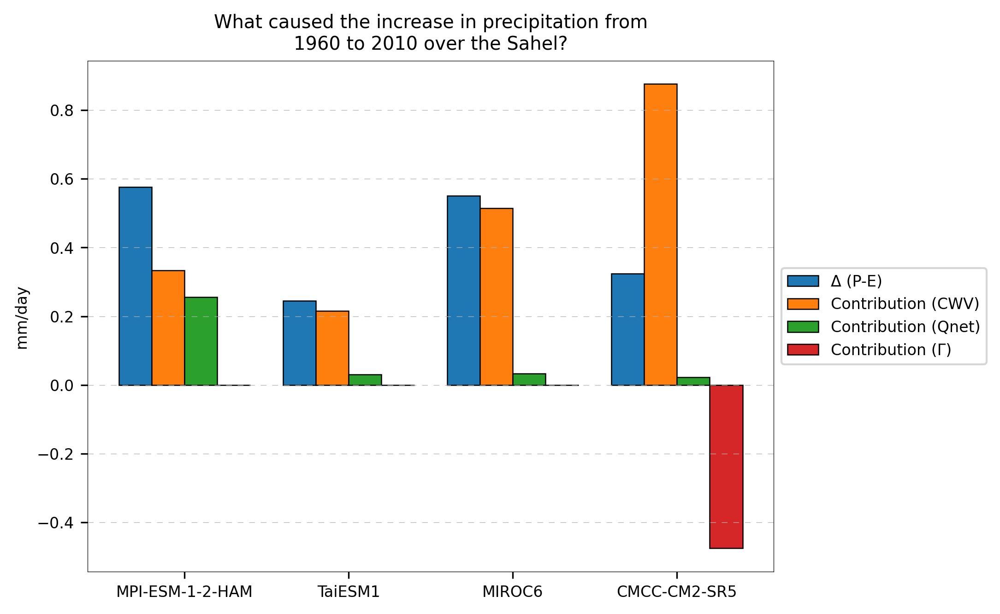

In [ ]:
for i in range(len(models)):
  df_sel = df_ta.query('source_id == '+'"'+models[i]+'"')
  zstores = df_sel.zstore.values
  mappers = [gcs.get_mapper(zstore) for zstore in zstores]
  ds = xr.open_mfdataset(mappers, engine='zarr', consolidated=True, compat='override')
  print(models[i] +' loaded')
  grid1 = ds.sel(lat=slice(lat1,lat2), lon=slice(lon1,lon2))
  lon_grid, lat_grid = np.meshgrid(grid1.lon, grid1.lat)
  mask1 = globe.is_land(lat_grid, lon_grid)

  months = grid1.time.dt.month.isin(range(6, 10)) #JJAS
  clim = grid1.sel(time=months)
  clim2 = clim.resample(time="10YS").mean()  # For decadal
  clim3 = clim2.where(mask1>0).mean(dim=['lat', 'lon'])
  Pwat = clim3.prw
  PE = 86400*26.16*(clim3.pr-clim3.evspsbl)
  Qnet = clim3.rsdt - clim3.rsut - clim3.rlut
  E = 86400*26.16*(clim3.evspsbl)
  Pr = 86400*(clim3.pr)

  TGMS = Qnet/PE
  rec = 1/Pwat

  def objective(X, a, b, c):
    x,y = X
    return a*x + b*y*x + c

  x1, y1 = rec, gammas[i]
  lower_bounds = [0, -np.inf, -np.inf]
  upper_bounds = [np.inf, 0, np.inf] # This is the key change
  popt1, _ = curve_fit(objective, (x1, y1), TGMS, bounds=(lower_bounds, upper_bounds))
  c1, c2, c3= popt1
  print(popt1)

  a=11 # for recovery from drought (1960)
  b=-2 # for 2000-2010
  #b=7


  #Reference values
  PE1 = np.average(PE[a])/26.16
  Pw1 = np.average(Pwat[a])
  Q1 = np.average(Qnet[a])/26.16
  gamma1 = np.average(y1[a])

  PE2 = np.average(PE[b])/26.16
  Pw2 = np.average(Pwat[b])
  Q2 = np.average(Qnet[b])/26.16
  gamma2 = np.average(y1[b])

  dP = PE2-PE1
  dPw = Pw2-Pw1
  dgamma = gamma2 - gamma1
  dQ = Q2-Q1

  Pwcontri = (dPw*Q1*(c1+c2*gamma1)*PE1)/(Q1*Pw1*(c1+c2*(gamma1+dgamma)+c3*(Pw1+dPw)))
  Qcontri = (dQ*(c1*Pw1+c2*gamma1*Pw1+c3*(Pw1**2))*PE1)/(Q1*Pw1*(c1+c2*(gamma1+dgamma)+c3*(Pw1+dPw)))
  Ccontri = (-1*Q1*Pw1*c2*dgamma*PE1)/(Q1*Pw1*(c1+c2*(gamma1+dgamma)+c3*(Pw1+dPw)))

  print(Ccontri)
  if b==7:
    # run this for Drought diagnostics
    ar1=np.array(dP)
    ar2=np.array(Pwcontri)
    ar3=np.array(Qcontri)
    ar4=np.array(Ccontri)
    dP=-1*ar1
    Pwcontri=-1*ar2
    Qcontri=-1*ar3
    Ccontri=-1*ar3

  w = 0.2
  plt.bar(i-3*w/2, dP, edgecolor='black', linewidth=0.6, facecolor='tab:blue', width=w)
  plt.bar(i-w/2, Pwcontri, edgecolor='black', linewidth=0.6, facecolor='tab:orange', width=w)
  plt.bar(i+w/2, Qcontri, edgecolor='black', linewidth=0.6, facecolor='tab:green', width=w)
  plt.bar(i+3*w/2, Ccontri, edgecolor='black', linewidth=0.6, facecolor='tab:red', width=w)
  #plt.xlim(-2, 5)
  print(models[i] +' done\n')

plt.ylabel('mm/day')
plt.legend(['\u0394 (P-E)', 'Contribution (CWV)', 'Contribution (Qnet)', 'Contribution (\u0393)'], loc='center left', bbox_to_anchor=(1, 0.5))
plt.grid(axis='y', ls="dashed", lw=0.3, dashes=(10,10))
plt.xticks([0,1,2,3],models)
plt.title('What caused the increase in precipitation from\n1960 to 2010 over the Sahel?')
plt.show()

In [ ]:
#New calculation for all models
pwatspread1 = []
gammaspread1 = []
qnetspread1 = []
dpspread1 = []
pwatspread2 = []
gammaspread2 = []
qnetspread2 = []
dpspread2 = []
c1list = []
c2list = []
c3list = []
for i in range(len(models)):
  df_sel = df_ta.query('source_id == '+'"'+models[i]+'"')
  zstores = df_sel.zstore.values
  mappers = [gcs.get_mapper(zstore) for zstore in zstores]
  ds = xr.open_mfdataset(mappers, engine='zarr', consolidated=True, compat='override')
  print(models[i] +' loaded')
  grid1 = ds.sel(lat=slice(lat1,lat2), lon=slice(lon1,lon2))
  lon_grid, lat_grid = np.meshgrid(grid1.lon, grid1.lat)
  mask1 = globe.is_land(lat_grid, lon_grid)

  months = grid1.time.dt.month.isin(range(6, 10)) #JJAS
  clim = grid1.sel(time=months)
  clim2 = clim.resample(time="10YS").mean()  # For decadal
  clim3 = clim2.where(mask1>0).mean(dim=['lat', 'lon'])
  Pwat = clim3.prw
  PE = 86400*26.16*(clim3.pr-clim3.evspsbl)
  Qnet = clim3.rsdt - clim3.rsut - clim3.rlut
  E = 86400*26.16*(clim3.evspsbl)
  Pr = 86400*(clim3.pr)

  TGMS = Qnet/PE
  rec = 1/Pwat

  def objective(X, a, b, c):
    x,y = X
    return a*x + b*y*x + c

  x1, y1 = rec, xr.DataArray(gammas[i], coords=[PE.time], dims='time')
  lower_bounds = [0, -np.inf, -np.inf]
  upper_bounds = [np.inf, 0, np.inf] # This is the key change
  popt1, _ = curve_fit(objective, (x1, y1), TGMS, bounds=(lower_bounds, upper_bounds))
  c1, c2, c3= popt1
  c1list.append(c1)
  c2list.append(c2)
  c3list.append(c3)
  print(popt1)

  drought = PE.sel(time=slice('1950', '1980'))
  drought_sel = drought.argmin(dim='time')
  recovery = PE.sel(time=slice('1990', '2010'))
  recovery_sel = recovery.argmax(dim='time')

  normal = PE.sel(time=slice('1900', '1920'))
  normal_an = abs(normal-np.mean(PE))
  normal_sel = normal_an.argmin(dim='time')

  a = drought_sel.values
  b = recovery_sel.values
  c = normal_sel.values

  #Reference values
  PE1 = np.average(PE.sel(time=drought.time[a]))/26.16
  Pw1 = np.average(Pwat.sel(time=drought.time[a]))
  Q1 = np.average(Qnet.sel(time=drought.time[a]))/26.16
  gamma1 = np.average(y1.sel(time=drought.time[a]))

  PE2 = np.average(PE.sel(time=recovery.time[b]))/26.16
  Pw2 = np.average(Pwat.sel(time=recovery.time[b]))
  Q2 = np.average(Qnet.sel(time=recovery.time[b]))/26.16
  gamma2 = np.average(y1.sel(time=recovery.time[b]))

  PE3 = np.average(PE.sel(time=normal.time[c]))/26.16
  Pw3 = np.average(Pwat.sel(time=normal.time[c]))
  Q3 = np.average(Qnet.sel(time=normal.time[c]))/26.16
  gamma3 = np.average(y1.sel(time=normal.time[c]))

  dP1 = PE2-PE1
  dPw1 = Pw2-Pw1
  dgamma1 = gamma2 - gamma1
  dQ1 = Q2-Q1

  dP2 = PE1-PE3
  dPw2 = Pw1-Pw3
  dgamma2 = gamma1 - gamma3
  dQ2 = Q1-Q3

  Pwcontri1 = (dPw1*Q1*(c1+c2*gamma1)*PE1)/(Q1*Pw1*(c1+c2*(gamma1+dgamma1)+c3*(Pw1+dPw1)))
  Qcontri1 = (dQ1*(c1*Pw1+c2*gamma1*Pw1+c3*(Pw1**2))*PE1)/(Q1*Pw1*(c1+c2*(gamma1+dgamma1)+c3*(Pw1+dPw1)))
  Ccontri1 = (-1*Q1*Pw1*c2*dgamma1*PE1)/(Q1*Pw1*(c1+c2*(gamma1+dgamma1)+c3*(Pw1+dPw1)))

  Pwcontri2 = (dPw2*Q3*(c1+c2*gamma3)*PE3)/(Q3*Pw3*(c1+c2*(gamma3+dgamma2)+c3*(Pw3+dPw2)))
  Qcontri2 = (dQ2*(c1*Pw3+c2*gamma3*Pw3+c3*(Pw3**2))*PE3)/(Q3*Pw3*(c1+c2*(gamma3+dgamma2)+c3*(Pw3+dPw2)))
  Ccontri2 = (-1*Q3*Pw3*c2*dgamma2*PE3)/(Q3*Pw3*(c1+c2*(gamma3+dgamma2)+c3*(Pw3+dPw2)))

  pwatspread1.append(Pwcontri1)
  gammaspread1.append(Ccontri1)
  qnetspread1.append(Qcontri1)
  dpspread1.append(dP1)
  pwatspread2.append(Pwcontri2)
  gammaspread2.append(Ccontri2)
  qnetspread2.append(Qcontri2)
  dpspread2.append(dP2)

FGOALS-g3 loaded
[32525.23512914 -4201.64652496  -166.88011997]
MPI-ESM1-2-HR loaded
[ 2.50297049e+02 -4.45579988e-16 -3.26050646e+00]
CAS-ESM2-0 loaded
[ 3.19244020e+02 -3.10904613e-05 -5.74374217e+00]
CanESM5 loaded
[ 1.00968360e-15 -1.67806384e+02  2.68424957e+01]
MPI-ESM1-2-LR loaded
[1403.02348783 -179.39083253   -1.68278473]
BCC-CSM2-MR loaded
[2584.56636571 -316.44518786   -8.6881426 ]
INM-CM4-8 loaded
[ 1.46650549e+03 -1.54624812e-12 -3.22184990e+01]
AWI-CM-1-1-MR loaded
[ 4.27054675e+02 -2.60488042e-17 -9.30956265e+00]
KACE-1-0-G loaded
[6009.50897401 -708.58948311  -29.99765896]
MRI-ESM2-0 loaded
[ 79025.65256228 -10430.43317684   -213.98667383]
CESM2-FV2 loaded
[430.80057486 -44.49431954  -2.33812367]
IPSL-CM6A-LR loaded
[5310.41891979 -698.34718154  -16.11918129]
CESM2 loaded
[516.7967904  -47.41824695  -4.03262544]
CESM2-WACCM-FV2 loaded
[ 1.30203829e+02 -1.07517736e+01 -7.72931199e-02]
CESM2-WACCM loaded
[ 1.62140868e+02 -3.53341488e-16 -3.10511432e+00]
TaiESM1 loaded
[ 5

/tmp/ipython-input-355650008.py:33: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  triangle_cmap = plt.cm.get_cmap('tab10', len(dpspread2)) # Using a colormap for distinct colors


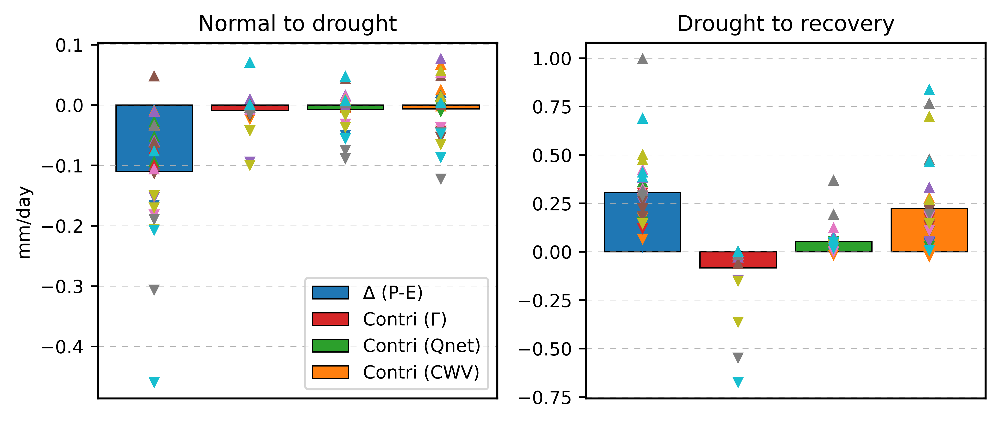

In [ ]:
X = np.arange(1850, 2020, 10)
plt.rcParams['figure.figsize'] = [7,3]
fig, axes = plt.subplot_mosaic([['(a)','(b)']])
labels = ['(a)', '(b)']

# Assuming you have the following arrays from your previous calculations:
# dpspread, gammaspread, qnetspread, pwatspread

# Calculate the average values
avg_dp2 = np.average(dpspread2)
avg_gamma2 = np.average(gammaspread2)
avg_qnet2 = np.average(qnetspread2)
avg_pwat2 = np.average(pwatspread2)
avg_dp1 = np.average(dpspread1)
avg_gamma1 = np.average(gammaspread1)
avg_qnet1 = np.average(qnetspread1)
avg_pwat1 = np.average(pwatspread1)

# Bar positions and labels
x_pos = np.arange(4)
labels = ['Δ (P-E)', 'Contri (Γ)', 'Contri (Qnet)', 'Contri (CWV)']
avg_values1 = [avg_dp1, avg_gamma1, avg_qnet1, avg_pwat1]
avg_values2 = [avg_dp2, avg_gamma2, avg_qnet2, avg_pwat2]
spread_values1 = [dpspread1, gammaspread1, qnetspread1, pwatspread1]
spread_values2 = [dpspread2, gammaspread2, qnetspread2, pwatspread2]
colors = ['tab:blue', 'tab:red', 'tab:green', 'tab:orange']

# Plot the bars
axes['(a)'].bar(x_pos, avg_values2, color=colors, edgecolor='black', linewidth=0.6, label=labels)
axes['(b)'].bar(x_pos, avg_values1, color=colors, edgecolor='black', linewidth=0.6)

# Define a list of colors for the triangles using the deprecated method, as the new one is not available
triangle_cmap = plt.cm.get_cmap('tab10', len(dpspread2)) # Using a colormap for distinct colors

# Add individual triangle markers for each spread value
for i in range(len(x_pos)):
    # Use a different set of colors for each bar's triangles, or cycle through a list
    # For simplicity, let's cycle through the colormap for each bar's triangles
    for j, value in enumerate(spread_values2[i]):
        if value >= avg_values2[i]:
            # Plot upward triangle if the value is above or equal to the mean
            axes['(a)'].plot(x_pos[i], value, '^', color=triangle_cmap(j % len(spread_values2[i])), markersize=4)
        else:
            # Plot downward triangle if the value is below the mean
            axes['(a)'].plot(x_pos[i], value, 'v', color=triangle_cmap(j % len(spread_values2[i])), markersize=4)
    for j, value in enumerate(spread_values1[i]):
        if value >= avg_values1[i]:
            # Plot upward triangle if the value is above or equal to the mean
            axes['(b)'].plot(x_pos[i], value, '^', color=triangle_cmap(j % len(spread_values1[i])), markersize=4)
        else:
            # Plot downward triangle if the value is below the mean
            axes['(b)'].plot(x_pos[i], value, 'v', color=triangle_cmap(j % len(spread_values1[i])), markersize=4)


axes['(a)'].legend(labels)
axes['(a)'].set_xticks(x_pos, [])
axes['(a)'].set_ylabel('mm/day')
axes['(a)'].set_title('Normal to drought')
axes['(a)'].grid(axis='y', ls="dashed", lw=0.3, dashes=(10,10))

axes['(b)'].tick_params(
    axis='x',          # changes apply to the x-axis
    which='both',      # both major and minor ticks are affected
    bottom=False,      # ticks along the bottom edge are off
    top=False,         # ticks along the top edge are off
    labelbottom=False) # labels along the bottom edge are off

axes['(a)'].tick_params(
    axis='x',          # changes apply to the x-axis
    which='both',      # both major and minor ticks are affected
    bottom=False,      # ticks along the bottom edge are off
    top=False,         # ticks along the top edge are off
    labelbottom=False) # labels along the bottom edge are off

axes['(b)'].set_title('Drought to recovery')
axes['(b)'].grid(axis='y', ls="dashed", lw=0.3, dashes=(10,10))
plt.tight_layout()

plt.show()

In [ ]:
np.array(c1list)

array([3.25252351e+04, 2.50297049e+02, 3.19244020e+02, 1.00968360e-15,
       1.40302349e+03, 2.58456637e+03, 1.46650549e+03, 4.27054675e+02,
       6.00950897e+03, 7.90256526e+04, 4.30800575e+02, 5.31041892e+03,
       5.16796790e+02, 1.30203829e+02, 1.62140868e+02, 5.17916257e+02,
       1.45193352e+03, 1.48925375e+02, 1.79305383e+03, 1.57992332e+04,
       4.97082126e+02, 9.99749818e+01, 1.00986211e+02, 3.06601112e+03,
       5.77457669e+03, 7.01442831e+00, 2.13370927e+02, 6.31869780e+03])

In [ ]:
np.array(c2list)

array([-4.20164652e+03, -4.45579988e-16, -3.10904613e-05, -1.67806384e+02,
       -1.79390833e+02, -3.16445188e+02, -1.54624812e-12, -2.60488042e-17,
       -7.08589483e+02, -1.04304332e+04, -4.44943195e+01, -6.98347182e+02,
       -4.74182470e+01, -1.07517736e+01, -3.53341488e-16, -3.07134147e-18,
       -1.64471303e+02, -1.36742288e-15, -1.74157250e+02, -2.03077353e+03,
       -5.89547898e+01, -1.03565298e-07, -6.19101961e-09, -4.06057919e+02,
       -7.21937381e+02, -4.71913147e-08, -8.51098705e-17, -8.14671454e+02])

In [ ]:
np.array(c3list)

array([-1.66880120e+02, -3.26050646e+00, -5.74374217e+00,  2.68424957e+01,
       -1.68278473e+00, -8.68814260e+00, -3.22184990e+01, -9.30956265e+00,
       -2.99976590e+01, -2.13986674e+02, -2.33812367e+00, -1.61191813e+01,
       -4.03262544e+00, -7.72931199e-02, -3.10511432e+00, -1.07366095e+01,
       -9.20671491e+00, -2.38582041e+00, -1.40577450e+01, -4.69329736e+01,
       -1.50476777e+00, -1.94443197e+00, -1.61181538e+00, -6.16958275e+00,
       -1.93763291e+01,  1.22306772e+00, -4.03828813e+00, -1.65656978e+01])

In [ ]:
c1list[0]

np.float64(32525.23512914482)

In [ ]:
#New calculation for all models
pwatspread = []
gammaspread = []
qnetspread = []
dpspread = []
#c1list = []
#c2list = []
#c3list = []
for i in range(len(models)):
  df_sel = df_ta.query('source_id == '+'"'+models[i]+'"')
  zstores = df_sel.zstore.values
  mappers = [gcs.get_mapper(zstore) for zstore in zstores]
  ds = xr.open_mfdataset(mappers, engine='zarr', consolidated=True, compat='override')
  print(models[i] +' loaded')
  grid1 = ds.sel(lat=slice(lat1,lat2), lon=slice(lon1,lon2))
  lon_grid, lat_grid = np.meshgrid(grid1.lon, grid1.lat)
  mask1 = globe.is_land(lat_grid, lon_grid)

  months = grid1.time.dt.month.isin(range(6, 10)) #JJAS
  clim = grid1.sel(time=months)
  clim2 = clim.resample(time="10YS").mean()  # For decadal
  clim3 = clim2.where(mask1>0).mean(dim=['lat', 'lon'])
  Pwat = clim3.prw
  PE = 86400*26.16*(clim3.pr-clim3.evspsbl)
  Qnet = clim3.rsdt - clim3.rsut - clim3.rlut
  E = 86400*26.16*(clim3.evspsbl)
  Pr = 86400*(clim3.pr)

  TGMS = Qnet/PE
  rec = 1/Pwat

  def objective(X, a, b, c):
    x,y = X
    return a*x + b*y*x + c

  x1, y1 = rec, xr.DataArray(gammas[i], coords=[PE.time], dims='time')
  c1,c2,c3 = c1list[i],c2list[i],c3list[i]

  #lower_bounds = [0, -np.inf, -np.inf]
  #upper_bounds = [np.inf, 0, np.inf] # This is the key change
  #popt1, _ = curve_fit(objective, (x1, y1), TGMS, bounds=(lower_bounds, upper_bounds))
  #c1, c2, c3= popt1
  #c1list.append(c1)
  #c2list.append(c2)
  #c3list.append(c3)
  #print(popt1)

  drought = PE.sel(time=slice('1950', '1980'))
  drought_sel = drought.argmin(dim='time')
  #recovery = PE.sel(time=slice('1990', '2010'))
  #recovery_sel = recovery.argmax(dim='time')

  normal = PE.sel(time=slice('1900', '1920'))
  #normal_an = abs(normal-np.mean(PE))
  #normal_sel = normal_an.argmin(dim='time')
  normal_sel = normal.argmax(dim='time')

  #a = drought_sel.values
  #b = recovery_sel.values

  a = normal_sel.values
  b = drought_sel.values

  #Reference values
  PE1 = np.average(PE.sel(time=normal.time[a]))/26.16
  Pw1 = np.average(Pwat.sel(time=normal.time[a]))
  Q1 = np.average(Qnet.sel(time=normal.time[a]))/26.16
  gamma1 = np.average(y1.sel(time=normal.time[a]))

  PE2 = np.average(PE.sel(time=drought.time[b]))/26.16
  Pw2 = np.average(Pwat.sel(time=drought.time[b]))
  Q2 = np.average(Qnet.sel(time=drought.time[b]))/26.16
  gamma2 = np.average(y1.sel(time=drought.time[b]))

  dP = PE2-PE1
  dPw = Pw2-Pw1
  dgamma = gamma2 - gamma1
  dQ = Q2-Q1

  Pwcontri = (dPw*Q1*(c1+c2*gamma1)*PE1)/(Q1*Pw1*(c1+c2*(gamma1+dgamma)+c3*(Pw1+dPw)))
  Qcontri = (dQ*(c1*Pw1+c2*gamma1*Pw1+c3*(Pw1**2))*PE1)/(Q1*Pw1*(c1+c2*(gamma1+dgamma)+c3*(Pw1+dPw)))
  Ccontri = (-1*Q1*Pw1*c2*dgamma*PE1)/(Q1*Pw1*(c1+c2*(gamma1+dgamma)+c3*(Pw1+dPw)))

  pwatspread.append(Pwcontri)
  gammaspread.append(Ccontri)
  qnetspread.append(Qcontri)
  dpspread.append(dP)

FGOALS-g3 loaded
MPI-ESM1-2-HR loaded
CAS-ESM2-0 loaded
CanESM5 loaded
MPI-ESM1-2-LR loaded
BCC-CSM2-MR loaded
INM-CM4-8 loaded
AWI-CM-1-1-MR loaded
KACE-1-0-G loaded
MRI-ESM2-0 loaded
CESM2-FV2 loaded
IPSL-CM6A-LR loaded
CESM2 loaded
CESM2-WACCM-FV2 loaded
CESM2-WACCM loaded
TaiESM1 loaded
E3SM-1-1-ECA loaded
NESM3 loaded
CMCC-CM2-HR4 loaded
CMCC-ESM2 loaded
NorESM2-MM loaded
MPI-ESM-1-2-HAM loaded
GFDL-CM4 loaded
AWI-ESM-1-1-LR loaded
CMCC-CM2-SR5 loaded
GFDL-ESM4 loaded
MIROC6 loaded
SAM0-UNICON loaded


# Spatial diagnostic estimations

Processing model: TaiESM1...


/tmp/ipython-input-2844042772.py:74: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  popt_map = xr.apply_ufunc(


Processing model: E3SM-1-1-ECA...


/tmp/ipython-input-2844042772.py:74: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  popt_map = xr.apply_ufunc(


Processing model: NESM3...


/tmp/ipython-input-2844042772.py:74: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  popt_map = xr.apply_ufunc(


Processing model: CMCC-CM2-HR4...


/tmp/ipython-input-2844042772.py:74: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  popt_map = xr.apply_ufunc(


Processing model: CMCC-ESM2...


/tmp/ipython-input-2844042772.py:74: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  popt_map = xr.apply_ufunc(


Processing model: NorESM2-MM...


/tmp/ipython-input-2844042772.py:74: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  popt_map = xr.apply_ufunc(


All models processed. Finalizing plot...


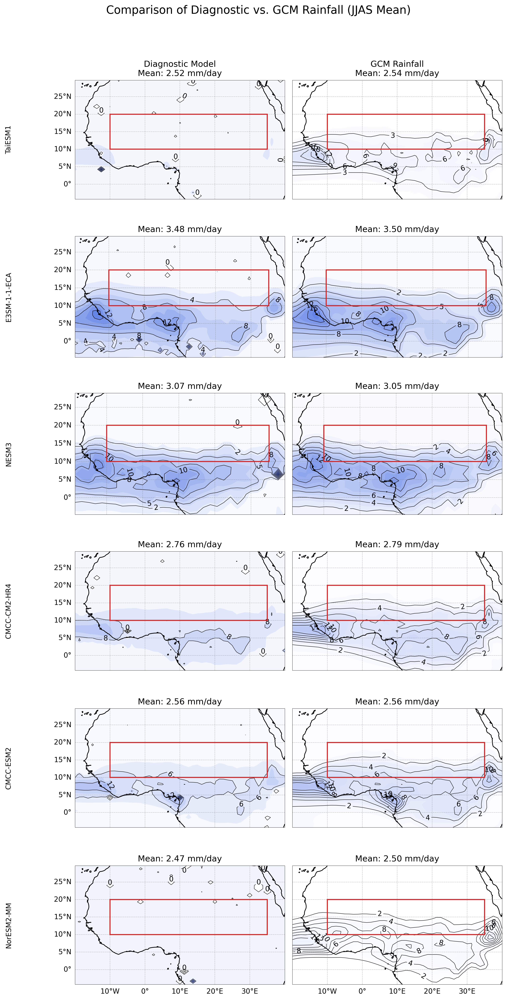

In [ ]:
fig, axs = plt.subplots(ncols=2, nrows=6,
                        subplot_kw={'projection': ccrs.PlateCarree()},
                        figsize=(10, 20))

# Define the custom white-to-blue colormap
colors = ["white", "royalblue"]
cmap_name = 'WhiteBlue'
white_blue_cmap = LinearSegmentedColormap.from_list(cmap_name, colors)


# --- Model and Region of Interest Setup ---
# Use the first 6 models for the 6 rows of the plot
models = ['TaiESM1', 'E3SM-1-1-ECA', 'NESM3', 'CMCC-CM2-HR4', 'CMCC-ESM2', 'NorESM2-MM']
lat3, lat4, lon3, lon4 = -5, 30, -20, 40 # Broad analysis region
lat1, lat2, lon1, lon2 = 10, 20, -10, 35 # Smaller box region


# --- Main Loop to Process and Plot Each Model ---
for i in range(len(models)):
    print(f"Processing model: {models[i]}...")
    # --- Data Loading and Preprocessing ---
    df_ta4 = df.query("table_id == 'Amon' & variable_id == ['pr', 'prw', 'rlut', 'rsdt', 'rsut', 'evspsbl', 'zg', 'ta'] & experiment_id == ['historical'] & member_id=='r1i1p1f1' & source_id=="+'"'+models[i]+'"')
    zstores = df_ta4.zstore.values
    mappers = [gcs.get_mapper(zstore) for zstore in zstores]

    # Use cftime=True for compatibility with different model calendars
    time_coder = xr.coders.CFDatetimeCoder(use_cftime=True)
    dl = xr.open_mfdataset(mappers, engine='zarr', consolidated=True, compat='override', decode_times=time_coder)

    # --- FIX: Drop bounds, which can interfere with time decoding ---
    # This makes the decoding step more robust for inconsistent models.
    dl = dl.drop_vars(["time_bnds", "lat_bnds", "lon_bnds"], errors="ignore")

    # Explicitly decode the CF conventions to ensure time is a datetime object
    dl = xr.decode_cf(dl)

    dl.coords['lon'] = (dl.coords['lon'] + 180) % 360 - 180
    dl2 = dl.sortby(dl.lon)

    grid1 = dl2.sel(plev=slice(100000, 10000), lat=slice(lat3, lat4), lon=slice(lon3, lon4))

    sel = range(6, 10) # JJAS months
    months = grid1.time.dt.month.isin(sel)
    clim = grid1.sel(time=months)
    clim = clim.resample(time='10YS').mean()

    # --- Variable and Parameter Calculation ---
    lapse_rate_map = xr.cov(clim.zg, clim.ta, dim='plev') / clim.zg.var(dim='plev', ddof=1)
    lapse_rate_map = 1000 * abs(lapse_rate_map) # in K/km

    PE = 86400 * (clim.pr - clim.evspsbl)
    E = 86400 * (clim.evspsbl)
    Qnet = (clim.rsdt - clim.rsut - clim.rlut)
    Pwat = clim.prw
    rec = 1 / Pwat
    TGMS = Qnet / PE

    def objective(X, a, b, c):
        x, y = X
        return a * x + b * y * x + c

    def curve_fit_wrapper(x1, y1, tgms):
        x_data = np.vstack((x1, y1))
        try:
            popt, _ = curve_fit(objective, x_data, tgms)
            return popt
        except RuntimeError:
            return np.array([np.nan, np.nan, np.nan])

    rec = rec.chunk(dict(time=-1))
    lapse_rate_map = lapse_rate_map.chunk(dict(time=-1))
    TGMS = TGMS.chunk(dict(time=-1))

    popt_map = xr.apply_ufunc(
        curve_fit_wrapper, rec, lapse_rate_map, TGMS,
        input_core_dims=[['time'], ['time'], ['time']],
        output_core_dims=[['params']],
        exclude_dims=set(['time']),
        dask="parallelized", vectorize=True,
        output_dtypes=[float], output_sizes={'params': 3}
    )
    a_map, b_map, c_map = popt_map.sel(params=0), popt_map.sel(params=1), popt_map.sel(params=2)

    TGMScal = objective((rec, lapse_rate_map), a_map, b_map, c_map)
    Pcal = Qnet / TGMScal

    # Calculate total rainfall for plotting
    model_precip = (Pcal + E).mean('time')
    gcm_precip = (PE + E).mean('time')

    # --- Plotting Section ---
    ax_left, ax_right = axs[i, 0], axs[i, 1]

    # --- FIX: Calculate spatial mean and add to subplot titles ---
    mean_model_precip = model_precip.mean().values
    mean_gcm_precip = gcm_precip.mean().values
    if i ==0:
      ax_left.set_title('Diagnostic Model\nMean: %.2f mm/day' %(mean_model_precip))
      ax_right.set_title('GCM Rainfall\nMean: %.2f mm/day' %(mean_gcm_precip))
    else:
      ax_left.set_title('Mean: %.2f mm/day' %(mean_model_precip))
      ax_right.set_title('Mean: %.2f mm/day' %(mean_gcm_precip))

    # Calculate a shared, symmetric maximum value for the color scale for this model
    vmax = max(abs(model_precip).max(), abs(gcm_precip).max()).values

    # Column 1: Plot Diagnostic Model Rainfall (Pcal + E)
    plot1 = ax_left.contourf(model_precip.lon, model_precip.lat, model_precip, cmap=white_blue_cmap,
                             transform=ccrs.PlateCarree(), vmin=0, vmax=vmax, levels=15)
    line1 = ax_left.contour(model_precip.lon, model_precip.lat, model_precip,
                            colors='black', transform=ccrs.PlateCarree(), linewidths=0.5)
    # --- FIX: Correct format string for contour labels ---
    ax_left.clabel(line1, colors=['black'], manual=False, inline=True, fmt='%.0f')

    # Column 2: Plot GCM Rainfall (PE + E)
    plot2 = ax_right.contourf(gcm_precip.lon, gcm_precip.lat, gcm_precip, cmap=white_blue_cmap,
                              transform=ccrs.PlateCarree(), vmin=0, vmax=vmax, levels=15)
    line2 = ax_right.contour(gcm_precip.lon, gcm_precip.lat, gcm_precip,
                             colors='black', transform=ccrs.PlateCarree(), linewidths=0.5)
    # --- FIX: Correct format string for contour labels ---
    ax_right.clabel(line2, colors=['black'], manual=False, inline=True, fmt='%.0f')

    # Add model name as a label for the row
    ax_left.text(-0.3, 0.5, models[i], transform=ax_left.transAxes,
                 fontsize=10, rotation=90, va='center', ha='right')

    # Add shared features to both plots in the row
    for ax in [ax_left, ax_right]:
        ax.coastlines()
        rect = mpatches.Rectangle((lon1, lat1), lon2 - lon1, lat2 - lat1,
                                  fill=False, edgecolor='tab:red', linewidth=1.5,
                                  transform=ccrs.PlateCarree(), zorder=10)
        ax.add_patch(rect)

print("All models processed. Finalizing plot...")

# --- Final Figure Formatting ---
# --- FIX: Removed old static titles ---

# Add gridlines and labels only to the outer axes to avoid clutter
for i, ax in enumerate(axs.flatten()):
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                      linewidth=0.5, color='gray', alpha=0.5, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    # Only show left labels on the first column
    gl.left_labels = (i % 2 == 0)
    # Only show bottom labels on the last row
    gl.bottom_labels = (i >= (len(models) - 1) * 2)

# No overall title
#fig.suptitle('Comparison of Diagnostic vs. GCM Rainfall (JJAS Mean)', fontsize=16, y=1.0)

# Adjust layout
plt.tight_layout(rect=[0, 0, 1, 0.98]) # Adjust rect to make space for suptitle
plt.show()

12
Processing model (1/12): TaiESM1...


/tmp/ipython-input-3578141010.py:81: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  popt_map = xr.apply_ufunc(


Processing model (2/12): E3SM-1-1-ECA...


/tmp/ipython-input-3578141010.py:81: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  popt_map = xr.apply_ufunc(


Processing model (3/12): NESM3...


/tmp/ipython-input-3578141010.py:81: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  popt_map = xr.apply_ufunc(


Processing model (4/12): CMCC-CM2-HR4...


/tmp/ipython-input-3578141010.py:81: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  popt_map = xr.apply_ufunc(


Processing model (5/12): CMCC-ESM2...


/tmp/ipython-input-3578141010.py:81: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  popt_map = xr.apply_ufunc(


Processing model (6/12): NorESM2-MM...


/tmp/ipython-input-3578141010.py:81: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  popt_map = xr.apply_ufunc(


Processing model (7/12): MPI-ESM-1-2-HAM...


/tmp/ipython-input-3578141010.py:81: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  popt_map = xr.apply_ufunc(


Processing model (8/12): GFDL-CM4...


/tmp/ipython-input-3578141010.py:81: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  popt_map = xr.apply_ufunc(


Processing model (9/12): AWI-ESM-1-1-LR...


/tmp/ipython-input-3578141010.py:81: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  popt_map = xr.apply_ufunc(


Processing model (10/12): CMCC-CM2-SR5...


/tmp/ipython-input-3578141010.py:81: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  popt_map = xr.apply_ufunc(


Processing model (11/12): GFDL-ESM4...


/tmp/ipython-input-3578141010.py:81: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  popt_map = xr.apply_ufunc(


Processing model (12/12): MIROC6...


/tmp/ipython-input-3578141010.py:81: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  popt_map = xr.apply_ufunc(


All models processed. Finalizing plot...


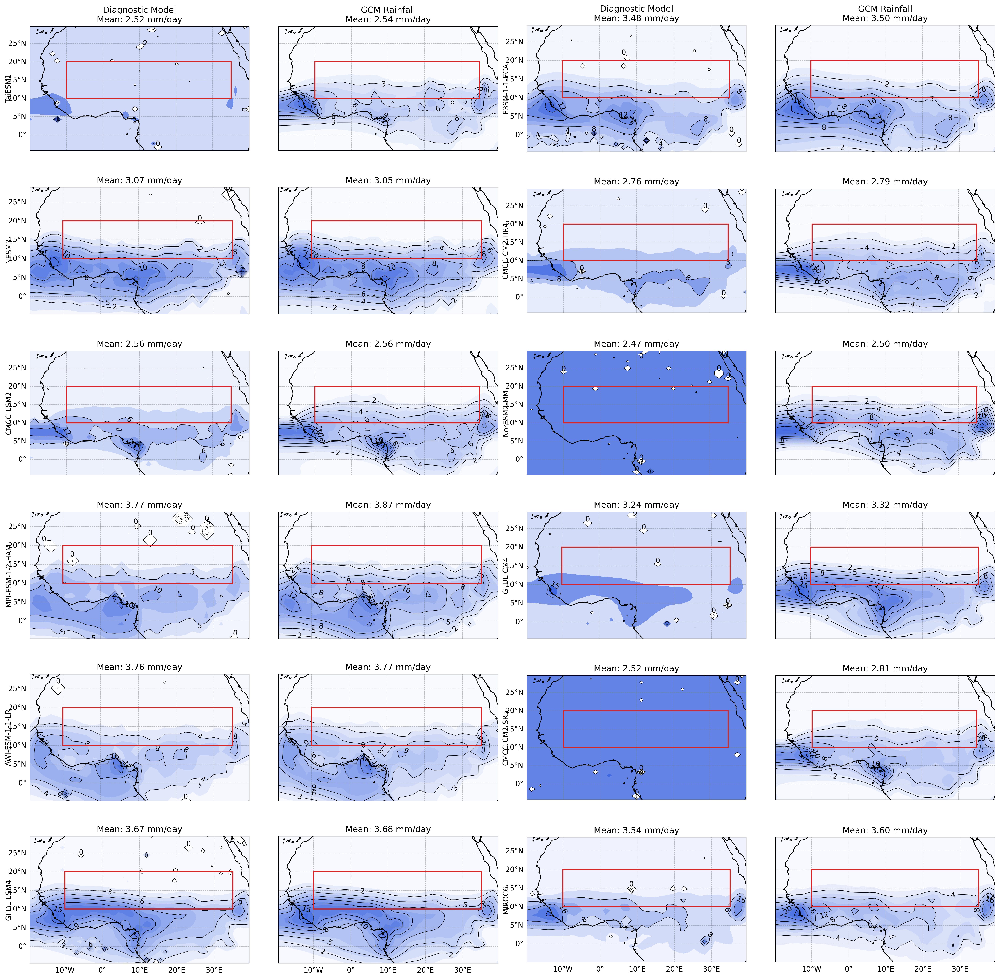

In [ ]:
# --- MODIFICATION: Updated subplot grid to 6 rows and 4 columns ---
fig, axs = plt.subplots(ncols=4, nrows=6,
                        subplot_kw={'projection': ccrs.PlateCarree()},
                        figsize=(20, 20)) # Adjusted figsize for new layout

# Define the custom white-to-blue colormap
colors = ["white", "royalblue"]
cmap_name = 'WhiteBlue'
white_blue_cmap = LinearSegmentedColormap.from_list(cmap_name, colors)


# --- MODIFICATION: Expanded model list to all 12 models ---
models = ['TaiESM1',
    'E3SM-1-1-ECA',
    'NESM3',
    'CMCC-CM2-HR4',
    'CMCC-ESM2',
    'NorESM2-MM',
    'MPI-ESM-1-2-HAM',
    'GFDL-CM4',
    'AWI-ESM-1-1-LR',
    'CMCC-CM2-SR5',
    'GFDL-ESM4',
    'MIROC6',]
print(len(models))
lat3, lat4, lon3, lon4 = -5, 30, -20, 40 # Broad analysis region
lat1, lat2, lon1, lon2 = 10, 20, -10, 35 # Smaller box region


# --- Main Loop to Process and Plot Each Model ---
for i in range(len(models)):
    print(f"Processing model ({i+1}/{len(models)}): {models[i]}...")
    # --- Data Loading and Preprocessing ---
    df_ta4 = df.query("table_id == 'Amon' & variable_id == ['pr', 'prw', 'rlut', 'rsdt', 'rsut', 'evspsbl', 'zg', 'ta'] & experiment_id == ['historical'] & member_id=='r1i1p1f1' & source_id=="+'"'+models[i]+'"')
    zstores = df_ta4.zstore.values
    mappers = [gcs.get_mapper(zstore) for zstore in zstores]

    time_coder = xr.coders.CFDatetimeCoder(use_cftime=True)
    dl = xr.open_mfdataset(mappers, engine='zarr', consolidated=True, compat='override', decode_times=time_coder)

    dl = dl.drop_vars(["time_bnds", "lat_bnds", "lon_bnds"], errors="ignore")
    dl = xr.decode_cf(dl)

    dl.coords['lon'] = (dl.coords['lon'] + 180) % 360 - 180
    dl2 = dl.sortby(dl.lon)

    grid1 = dl2.sel(plev=slice(100000, 10000), lat=slice(lat3, lat4), lon=slice(lon3, lon4))

    sel = range(6, 10) # JJAS months
    months = grid1.time.dt.month.isin(sel)
    clim = grid1.sel(time=months)
    clim = clim.resample(time='10YS').mean()

    # --- Variable and Parameter Calculation ---
    lapse_rate_map = xr.cov(clim.zg, clim.ta, dim='plev') / clim.zg.var(dim='plev', ddof=1)
    lapse_rate_map = 1000 * abs(lapse_rate_map)

    PE = 86400 * (clim.pr - clim.evspsbl)
    E = 86400 * (clim.evspsbl)
    Qnet = (clim.rsdt - clim.rsut - clim.rlut)
    Pwat = clim.prw
    rec = 1 / Pwat
    TGMS = Qnet / PE

    def objective(X, a, b, c):
        x, y = X
        return a * x + b * y * x + c

    def curve_fit_wrapper(x1, y1, tgms):
        x_data = np.vstack((x1, y1))
        try:
            popt, _ = curve_fit(objective, x_data, tgms)
            return popt
        except RuntimeError:
            return np.array([np.nan, np.nan, np.nan])

    rec = rec.chunk(dict(time=-1))
    lapse_rate_map = lapse_rate_map.chunk(dict(time=-1))
    TGMS = TGMS.chunk(dict(time=-1))

    popt_map = xr.apply_ufunc(
        curve_fit_wrapper, rec, lapse_rate_map, TGMS,
        input_core_dims=[['time'], ['time'], ['time']],
        output_core_dims=[['params']],
        exclude_dims=set(['time']),
        dask="parallelized", vectorize=True,
        output_dtypes=[float], output_sizes={'params': 3}
    )
    a_map, b_map, c_map = popt_map.sel(params=0), popt_map.sel(params=1), popt_map.sel(params=2)

    TGMScal = objective((rec, lapse_rate_map), a_map, b_map, c_map)
    Pcal = Qnet / TGMScal

    model_precip = (Pcal + E).mean('time')
    gcm_precip = (PE + E).mean('time')

    # --- MODIFICATION: Calculate row and column indices for the 6x4 grid ---
    row = i // 2
    col_start = (i % 2) * 2
    ax_left, ax_right = axs[row, col_start], axs[row, col_start + 1]

    mean_model_precip = model_precip.mean().values
    mean_gcm_precip = gcm_precip.mean().values

    # Add full titles only to the top row
    if row == 0:
      ax_left.set_title('Diagnostic Model\nMean: %.2f mm/day' % (mean_model_precip))
      ax_right.set_title('GCM Rainfall\nMean: %.2f mm/day' % (mean_gcm_precip))
    else:
      ax_left.set_title('Mean: %.2f mm/day' % (mean_model_precip))
      ax_right.set_title('Mean: %.2f mm/day' % (mean_gcm_precip))

    vmax = abs(gcm_precip).max().values

    # Plot Diagnostic Model Rainfall
    plot1 = ax_left.contourf(model_precip.lon, model_precip.lat, model_precip, cmap=white_blue_cmap,
                             transform=ccrs.PlateCarree(), vmin=0, vmax=vmax, levels=15)
    line1 = ax_left.contour(model_precip.lon, model_precip.lat, model_precip,
                            colors='black', transform=ccrs.PlateCarree(), linewidths=0.5)
    ax_left.clabel(line1, colors=['black'], manual=False, inline=True, fmt='%.0f')

    # Plot GCM Rainfall
    plot2 = ax_right.contourf(gcm_precip.lon, gcm_precip.lat, gcm_precip, cmap=white_blue_cmap,
                              transform=ccrs.PlateCarree(), vmin=0, vmax=vmax, levels=15)
    line2 = ax_right.contour(gcm_precip.lon, gcm_precip.lat, gcm_precip,
                             colors='black', transform=ccrs.PlateCarree(), linewidths=0.5)
    ax_right.clabel(line2, colors=['black'], manual=False, inline=True, fmt='%.0f')

    # --- MODIFICATION: Add model name as a label for each plot pair ---
    ax_left.text(-0.1, 0.5, models[i], transform=ax_left.transAxes, rotation=90, va='center', ha='right')

    for ax in [ax_left, ax_right]:
        ax.coastlines()
        rect = mpatches.Rectangle((lon1, lat1), lon2 - lon1, lat2 - lat1,
                                  fill=False, edgecolor='tab:red', linewidth=1.5,
                                  transform=ccrs.PlateCarree(), zorder=10)
        ax.add_patch(rect)

print("All models processed. Finalizing plot...")

# --- Final Figure Formatting ---
for i, ax in enumerate(axs.flatten()):
    row = i // 4
    col = i % 4
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                      linewidth=0.5, color='gray', alpha=0.5, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False

    # --- MODIFICATION: Updated logic for outer labels on a 6x4 grid ---
    # Only show left labels on the first column of each model pair
    gl.left_labels = (col % 2 == 0)
    # Only show bottom labels on the last row (row index 5)
    gl.bottom_labels = (row == 5)

# Adjust layout
plt.tight_layout(rect=[0.02, 0, 1, 0.98])
plt.show()

# Spatial change graphs

In [ ]:
models = ['MPI-ESM-1-2-HAM', 'MIROC6', 'CMCC-CM2-SR5', 'TaiESM1']

In [ ]:
lat3, lat4, lon3, lon4 = -5, 30, -20, 40
select_date_1970 = cftime.DatetimeNoLeap(1970, 1, 1)
select_date_2000 = cftime.DatetimeNoLeap(2000, 1, 1)

/tmp/ipython-input-3207973087.py:19: DeprecationWarning: Usage of 'use_cftime' as a kwarg is deprecated. Please pass a 'CFDatetimeCoder' instance initialized with 'use_cftime' to the 'decode_times' kwarg instead.
Example usage:
    time_coder = xr.coders.CFDatetimeCoder(use_cftime=True)
    ds = xr.open_dataset(decode_times=time_coder)

  dl = xr.open_mfdataset(mappers, engine='zarr', consolidated=True, compat='override', use_cftime=True)
/tmp/ipython-input-3207973087.py:19: DeprecationWarning: Usage of 'use_cftime' as a kwarg is deprecated. Please pass a 'CFDatetimeCoder' instance initialized with 'use_cftime' to the 'decode_times' kwarg instead.
Example usage:
    time_coder = xr.coders.CFDatetimeCoder(use_cftime=True)
    ds = xr.open_dataset(decode_times=time_coder)

  dl = xr.open_mfdataset(mappers, engine='zarr', consolidated=True, compat='override', use_cftime=True)
/tmp/ipython-input-3207973087.py:19: DeprecationWarning: Usage of 'use_cftime' as a kwarg is deprecated. Please pa

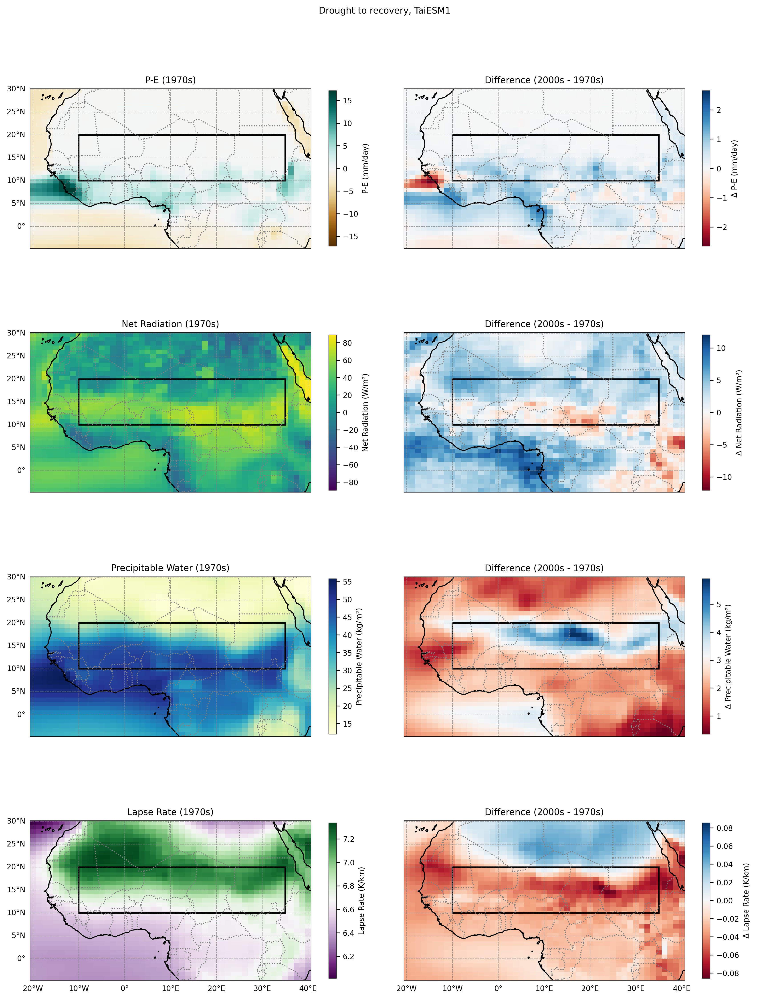

In [ ]:
# Create a 4x2 grid of subplots, specifying a map projection for each
fig, axs = plt.subplots(nrows=4, ncols=2,
                        subplot_kw={'projection': ccrs.PlateCarree()},
                        figsize=(12, 16))

# --- Model and Region of Interest Setup ---
models = ['TaiESM1']

# The main loop will only run once for the single model specified
for i in range(len(models)):
    # --- Data Loading and Preprocessing ---
    # Query the CMIP6 catalog for the required variables for the specified model
    df_ta4 = df.query("table_id == 'Amon' & variable_id == ['pr', 'prw', 'rlut', 'rsdt', 'rsut', 'evspsbl', 'zg', 'ta'] & experiment_id == ['historical'] & member_id=='r1i1p1f1' & source_id=="+'"'+models[i]+'"')
    zstores = df_ta4.zstore.values
    mappers = [gcs.get_mapper(zstore) for zstore in zstores]

    # --- FIX 3: Reverted to user's preferred open_mfdataset method ---
    dl = xr.open_mfdataset(mappers, engine='zarr', consolidated=True, compat='override')

    # Convert longitude from 0-360 to -180-180
    dl.coords['lon'] = (dl.coords['lon'] + 180) % 360 - 180
    dl2 = dl.sortby(dl.lon)

    # Select the broader spatial domain and pressure levels
    grid1 = dl2.sel(plev=slice(100000, 10000), lat=slice(lat3, lat4), lon=slice(lon3, lon4))

    # --- Temporal Filtering and Resampling ---
    # Select only the months for JJAS (June, July, August, September)
    sel = range(6, 10)
    months = grid1.time.dt.month.isin(sel)
    clim = grid1.sel(time=months)
    # Resample the data to decadal means
    clim = clim.resample(time='10YS').mean()

    # --- Variable Calculation ---
    # Calculate the lapse rate map (K/m) for all grid cells and time steps
    lapse_rate_map = xr.cov(clim.zg, clim.ta, dim='plev') / clim.zg.var(dim='plev', ddof=1)
    lapse_rate_map = 1000*abs(lapse_rate_map) # Gamma is positive by definition

    # Calculate surface variables
    PE = 86400 * (clim.pr - clim.evspsbl) # P-E in mm/day
    Qnet = (clim.rsdt - clim.rsut - clim.rlut) # Net radiation in W/m^2
    Pwat = clim.prw # Precipitable water in kg/m^2

    # --- Data and Metadata for Plotting ---
    # List of variables to plot
    variables = [PE, Qnet, Pwat, lapse_rate_map]
    # Corresponding names and units for titles and colorbars
    var_names = ['P-E', 'Net Radiation', 'Precipitable Water', 'Lapse Rate']
    var_units = ['mm/day', 'W/m²', 'kg/m²', 'K/km']
    # Colormaps for each variable
    cmaps = ['BrBG', 'viridis', 'YlGnBu', 'PRGn']

    # --- Plotting Loop ---
    # Iterate through each row of the subplot grid
    for j in range(len(variables)):
        ax1 = axs[j, 0]
        ax2 = axs[j, 1]
        var_data = variables[j]

        # --- FIX 2: Use method='nearest' for robust time selection ---
        # This prevents "no data to plot" errors after resampling.
        data_1970 = var_data.sel(time=select_date_1970, method='nearest')
        data_2000 = var_data.sel(time=select_date_2000, method='nearest')

        # --- Column 1: Plot for the 1970s decade ---
        plot1 = data_1970.plot(ax=ax1, cmap=cmaps[j], transform=ccrs.PlateCarree(), add_colorbar=False)
        # Add a colorbar with the correct label
        cbar1 = fig.colorbar(plot1, ax=ax1, orientation='vertical', pad=0.05, shrink=0.6)
        cbar1.set_label(f'{var_names[j]} ({var_units[j]})')
        ax1.set_title(f'{var_names[j]} (1970s)')

        # --- Column 2: Plot for the difference (2000s - 1970s) ---
        diff_data = data_2000 - data_1970
        # Use a diverging colormap for difference plots
        plot2 = diff_data.plot(ax=ax2, cmap='RdBu', transform=ccrs.PlateCarree(), add_colorbar=False)
        # Add a colorbar with the correct label
        cbar2 = fig.colorbar(plot2, ax=ax2, orientation='vertical', pad=0.05, shrink=0.6)
        cbar2.set_label(f'Δ {var_names[j]} ({var_units[j]})')
        ax2.set_title(f'Difference (2000s - 1970s)')

    # --- Final Formatting for All Subplots ---
    for ax in axs.flatten():
        ax.coastlines()
        ax.add_feature(cfeature.BORDERS, linestyle=':', edgecolor='gray')

        # Add the rectangular box to highlight the smaller region
        rect = mpatches.Rectangle((lon1, lat1), lon2 - lon1, lat2 - lat1,
                                  fill=False,
                                  edgecolor='black',
                                  linewidth=1.5,
                                  transform=ccrs.PlateCarree())
        ax.add_patch(rect)

        # Set gridlines and labels
        gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                          linewidth=0.5, color='gray', alpha=0.5, linestyle='--')
        # Turn off labels by default, we will enable them only for outer axes
        gl.top_labels = False
        gl.right_labels = False
        gl.left_labels = False
        gl.bottom_labels = False

# --- Final Formatting and Labeling for All Subplots ---
# This block replaces the two separate formatting/labeling sections at the end of your script.
for i, ax in enumerate(axs.flatten()):
    # Calculate the row and column index from the flattened index 'i'
    row = i // 2  # Integer division gives the row number
    col = i % 2   # Modulo gives the column number

    ax.coastlines()
    ax.add_feature(cfeature.BORDERS, linestyle=':', edgecolor='gray')

    # Add the rectangular box to highlight the smaller region
    rect = mpatches.Rectangle((lon1, lat1), lon2 - lon1, lat2 - lat1,
                              fill=False,
                              edgecolor='black',
                              linewidth=1.5,
                              transform=ccrs.PlateCarree())
    ax.add_patch(rect)

    # Create the gridlines object
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                      linewidth=0.5, color='gray', alpha=0.5, linestyle='--')

    # --- FIX: Set label visibility using attributes ---
    gl.top_labels = False
    gl.right_labels = False

    # Conditionally turn on labels for the outer plots
    # Turn on left labels (latitude) ONLY for the first column (col == 0)
    gl.left_labels = (col == 0)
    # Turn on bottom labels (longitude) ONLY for the last row (row == 3)
    gl.bottom_labels = (row == 3)

fig.suptitle('Drought to recovery, '+models[0])
# Adjust layout to prevent titles and labels from overlapping
plt.tight_layout(pad=3.0)
plt.show()

# Percentage changes in each variable

In [ ]:
#New calculation for all models
delpwat1 = []
delgamma1 = []
delqnet1 = []
dele1 = []
delpwat2 = []
delgamma2 = []
delqnet2 = []
dele2 = []
for i in range(len(models)):
  df_sel = df_ta.query('source_id == '+'"'+models[i]+'"')
  zstores = df_sel.zstore.values
  mappers = [gcs.get_mapper(zstore) for zstore in zstores]
  ds = xr.open_mfdataset(mappers, engine='zarr', consolidated=True, compat='override')
  print(models[i] +' loaded')
  grid1 = ds.sel(lat=slice(lat1,lat2), lon=slice(lon1,lon2))
  lon_grid, lat_grid = np.meshgrid(grid1.lon, grid1.lat)
  mask1 = globe.is_land(lat_grid, lon_grid)

  months = grid1.time.dt.month.isin(range(6, 10)) #JJAS
  clim = grid1.sel(time=months)
  clim2 = clim.resample(time="10YS").mean()  # For decadal
  clim3 = clim2.where(mask1>0).mean(dim=['lat', 'lon'])
  Pwat = clim3.prw
  PE = (clim3.pr-clim3.evspsbl)
  Qnet = clim3.rsdt - clim3.rsut - clim3.rlut
  E = (clim3.evspsbl)
  #Pr = 86400*(clim3.pr)

  y1 = xr.DataArray(gammas[i], coords=[PE.time], dims='time')

  drought = PE.sel(time=slice('1950', '1980'))
  drought_sel = drought.argmin(dim='time')
  recovery = PE.sel(time=slice('1990', '2010'))
  recovery_sel = recovery.argmax(dim='time')

  normal = PE.sel(time=slice('1900', '1920'))
  normal_an = abs(normal-np.mean(PE))
  normal_sel = normal_an.argmin(dim='time')

  a = drought_sel.values
  b = recovery_sel.values
  c = normal_sel.values

  #Reference values
  E1 = np.average(E.sel(time=drought.time[a], method='nearest'))
  Pw1 = np.average(Pwat.sel(time=drought.time[a], method='nearest'))
  Q1 = np.average(Qnet.sel(time=drought.time[a], method='nearest'))
  gamma1 = np.average(y1.sel(time=drought.time[a], method='nearest'))

  E2 = np.average(E.sel(time=recovery.time[b], method='nearest'))
  Pw2 = np.average(Pwat.sel(time=recovery.time[b], method='nearest'))
  Q2 = np.average(Qnet.sel(time=recovery.time[b], method='nearest'))
  gamma2 = np.average(y1.sel(time=recovery.time[b], method='nearest'))

  E3 = np.average(E.sel(time=normal.time[c], method='nearest'))
  Pw3 = np.average(Pwat.sel(time=normal.time[c], method='nearest'))
  Q3 = np.average(Qnet.sel(time=normal.time[c], method='nearest'))
  gamma3 = np.average(y1.sel(time=normal.time[c], method='nearest'))

  delpwat1.append((Pw1-Pw3)/Pw3)
  delgamma1.append((gamma1-gamma3)/gamma3)
  delqnet1.append((Q1-Q3)/Q3)
  dele1.append((E1-E3)/E3)
  delpwat2.append((Pw2-Pw1)/Pw1)
  delgamma2.append((gamma2-gamma1)/gamma1)
  delqnet2.append((Q2-Q1)/Q1)
  dele2.append((E2-E1)/E1)

FGOALS-g3 loaded
MPI-ESM1-2-HR loaded
CAS-ESM2-0 loaded
CanESM5 loaded
MPI-ESM1-2-LR loaded
BCC-CSM2-MR loaded
INM-CM4-8 loaded
AWI-CM-1-1-MR loaded
KACE-1-0-G loaded
MRI-ESM2-0 loaded
CESM2-FV2 loaded
IPSL-CM6A-LR loaded
CESM2 loaded
CESM2-WACCM-FV2 loaded
CESM2-WACCM loaded
TaiESM1 loaded
E3SM-1-1-ECA loaded
NESM3 loaded
CMCC-CM2-HR4 loaded
CMCC-ESM2 loaded
NorESM2-MM loaded
MPI-ESM-1-2-HAM loaded
GFDL-CM4 loaded
AWI-ESM-1-1-LR loaded
CMCC-CM2-SR5 loaded
GFDL-ESM4 loaded
MIROC6 loaded
SAM0-UNICON loaded


/tmp/ipython-input-2923559818.py:33: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  triangle_cmap = plt.cm.get_cmap('tab10', len(dpspread2)) # Using a colormap for distinct colors


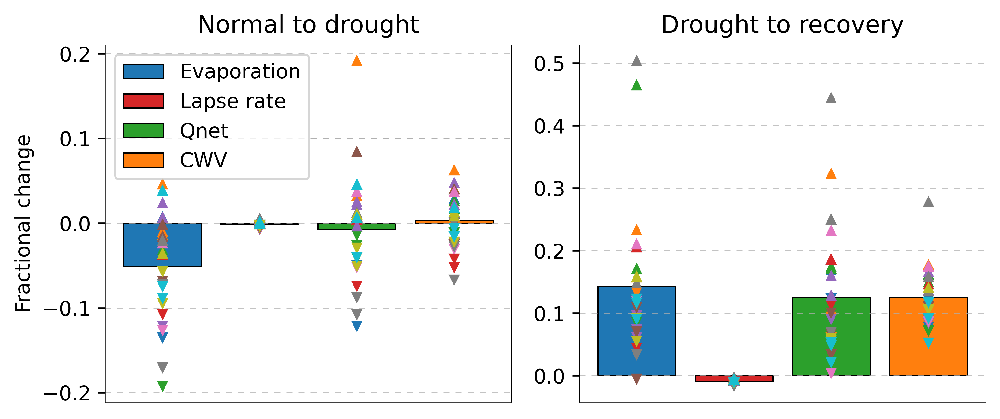

In [ ]:
X = np.arange(1850, 2020, 10)
plt.rcParams['figure.figsize'] = [7,3]
fig, axes = plt.subplot_mosaic([['(a)','(b)']])
labels = ['(a)', '(b)']

# Assuming you have the following arrays from your previous calculations:
# dpspread, gammaspread, qnetspread, pwatspread

# Calculate the average values
avg_de2 = np.average(dele2)
avg_gamma2 = np.average(delgamma2)
avg_qnet2 = np.average(delqnet2)
avg_pwat2 = np.average(delpwat2)
avg_de1 = np.average(dele1)
avg_gamma1 = np.average(delgamma1)
avg_qnet1 = np.average(delqnet1)
avg_pwat1 = np.average(delpwat1)

# Bar positions and labels
x_pos = np.arange(4)
labels = ['Evaporation', 'Lapse rate', 'Qnet', 'CWV']
avg_values1 = [avg_de1, avg_gamma1, avg_qnet1, avg_pwat1]
avg_values2 = [avg_de2, avg_gamma2, avg_qnet2, avg_pwat2]
spread_values1 = [dele1, delgamma1, delqnet1, delpwat1]
spread_values2 = [dele2, delgamma2, delqnet2, delpwat2]
colors = ['tab:blue', 'tab:red', 'tab:green', 'tab:orange']

# Plot the bars
axes['(a)'].bar(x_pos, avg_values1, color=colors, edgecolor='black', linewidth=0.6, label=labels)
axes['(b)'].bar(x_pos, avg_values2, color=colors, edgecolor='black', linewidth=0.6)

# Define a list of colors for the triangles using the deprecated method, as the new one is not available
triangle_cmap = plt.cm.get_cmap('tab10', len(dpspread2)) # Using a colormap for distinct colors

# Add individual triangle markers for each spread value
for i in range(len(x_pos)):
    # Use a different set of colors for each bar's triangles, or cycle through a list
    # For simplicity, let's cycle through the colormap for each bar's triangles
    for j, value in enumerate(spread_values1[i]):
        if value >= avg_values1[i]:
            # Plot upward triangle if the value is above or equal to the mean
            axes['(a)'].plot(x_pos[i], value, '^', color=triangle_cmap(j % len(spread_values1[i])), markersize=4)
        else:
            # Plot downward triangle if the value is below the mean
            axes['(a)'].plot(x_pos[i], value, 'v', color=triangle_cmap(j % len(spread_values1[i])), markersize=4)
    for j, value in enumerate(spread_values2[i]):
        if value >= avg_values2[i]:
            # Plot upward triangle if the value is above or equal to the mean
            axes['(b)'].plot(x_pos[i], value, '^', color=triangle_cmap(j % len(spread_values2[i])), markersize=4)
        else:
            # Plot downward triangle if the value is below the mean
            axes['(b)'].plot(x_pos[i], value, 'v', color=triangle_cmap(j % len(spread_values2[i])), markersize=4)


axes['(a)'].legend(labels)
axes['(a)'].set_xticks(x_pos, [])
axes['(a)'].set_ylabel('Fractional change')
axes['(a)'].set_title('Normal to drought')
axes['(a)'].grid(axis='y', ls="dashed", lw=0.3, dashes=(10,10))

axes['(b)'].tick_params(
    axis='x',          # changes apply to the x-axis
    which='both',      # both major and minor ticks are affected
    bottom=False,      # ticks along the bottom edge are off
    top=False,         # ticks along the top edge are off
    labelbottom=False) # labels along the bottom edge are off

axes['(a)'].tick_params(
    axis='x',          # changes apply to the x-axis
    which='both',      # both major and minor ticks are affected
    bottom=False,      # ticks along the bottom edge are off
    top=False,         # ticks along the top edge are off
    labelbottom=False) # labels along the bottom edge are off

axes['(b)'].set_title('Drought to recovery')
axes['(b)'].grid(axis='y', ls="dashed", lw=0.3, dashes=(10,10))
plt.tight_layout()

plt.show()

In [ ]:
#New calculation for all models
delins1 = []
delosr1 = []
delolr1 = []
delins2 = []
delosr2 = []
delolr2 = []
for i in range(len(models)):
  df_sel = df_ta.query('source_id == '+'"'+models[i]+'"')
  zstores = df_sel.zstore.values
  mappers = [gcs.get_mapper(zstore) for zstore in zstores]
  ds = xr.open_mfdataset(mappers, engine='zarr', consolidated=True, compat='override')
  print(models[i] +' loaded')
  grid1 = ds.sel(lat=slice(lat1,lat2), lon=slice(lon1,lon2))
  lon_grid, lat_grid = np.meshgrid(grid1.lon, grid1.lat)
  mask1 = globe.is_land(lat_grid, lon_grid)

  months = grid1.time.dt.month.isin(range(6, 10)) #JJAS
  clim = grid1.sel(time=months)
  clim2 = clim.resample(time="10YS").mean()  # For decadal
  clim3 = clim2.where(mask1>0).mean(dim=['lat', 'lon'])

  INS = clim3.rsdt
  OSR = clim3.rsut
  OLR = clim3.rlut
  PE = (clim3.pr-clim3.evspsbl)

  drought = PE.sel(time=slice('1950', '1980'))
  drought_sel = drought.argmin(dim='time')
  recovery = PE.sel(time=slice('1990', '2010'))
  recovery_sel = recovery.argmax(dim='time')

  normal = PE.sel(time=slice('1900', '1920'))
  normal_an = abs(normal-np.mean(PE))
  normal_sel = normal_an.argmin(dim='time')

  a = drought_sel.values
  b = recovery_sel.values
  c = normal_sel.values

  #Reference values
  INS1 = np.average(INS.sel(time=drought.time[a], method='nearest'))
  OSR1 = np.average(OSR.sel(time=drought.time[a], method='nearest'))
  OLR1 = np.average(OLR.sel(time=drought.time[a], method='nearest'))

  INS2 = np.average(INS.sel(time=recovery.time[b], method='nearest'))
  OSR2 = np.average(OSR.sel(time=recovery.time[b], method='nearest'))
  OLR2 = np.average(OLR.sel(time=recovery.time[b], method='nearest'))

  INS3 = np.average(INS.sel(time=normal.time[c], method='nearest'))
  OSR3 = np.average(OSR.sel(time=normal.time[c], method='nearest'))
  OLR3 = np.average(OLR.sel(time=normal.time[c], method='nearest'))

  #delins1.append((INS1-INS3)/INS3)
  #delosr1.append((OSR1-OSR3)/OSR3)
  #delolr1.append((OLR1-OLR3)/OLR3)
  #delins2.append((INS2-INS1)/INS1)
  #delosr2.append((OSR2-OSR1)/OSR1)
  #delolr2.append((OLR2-OLR1)/OLR1)

  delins1.append((INS1-INS3)) #This is for comparing d(OLR) and d(CWV)
  delosr1.append((OSR1-OSR3))
  delolr1.append((OLR1-OLR3))
  delins2.append((INS2-INS1))
  delosr2.append((OSR2-OSR1))
  delolr2.append((OLR2-OLR1))

FGOALS-g3 loaded
MPI-ESM1-2-HR loaded
CAS-ESM2-0 loaded
CanESM5 loaded
MPI-ESM1-2-LR loaded
BCC-CSM2-MR loaded
INM-CM4-8 loaded
AWI-CM-1-1-MR loaded
KACE-1-0-G loaded
MRI-ESM2-0 loaded
CESM2-FV2 loaded
IPSL-CM6A-LR loaded
CESM2 loaded
CESM2-WACCM-FV2 loaded
CESM2-WACCM loaded
TaiESM1 loaded
E3SM-1-1-ECA loaded
NESM3 loaded
CMCC-CM2-HR4 loaded
CMCC-ESM2 loaded
NorESM2-MM loaded
MPI-ESM-1-2-HAM loaded
GFDL-CM4 loaded
AWI-ESM-1-1-LR loaded
CMCC-CM2-SR5 loaded
GFDL-ESM4 loaded
MIROC6 loaded
SAM0-UNICON loaded


/tmp/ipython-input-2489360560.py:32: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  triangle_cmap = plt.cm.get_cmap('tab10', len(delins2)) # Using a colormap for distinct colors


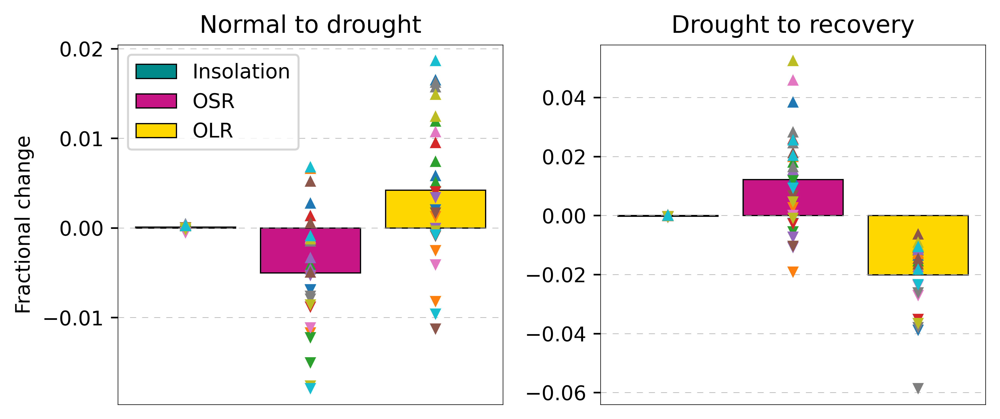

In [ ]:
X = np.arange(1850, 2020, 10)
plt.rcParams['figure.figsize'] = [7,3]
fig, axes = plt.subplot_mosaic([['(a)','(b)']])
labels = ['(a)', '(b)']

# Assuming you have the following arrays from your previous calculations:
# dpspread, gammaspread, qnetspread, pwatspread

# Calculate the average values
avg_olr2 = np.average(delolr2)
avg_olsr2 = np.average(delosr2)
avg_ins2 = np.average(delins2)

avg_olr1 = np.average(delolr1)
avg_olsr1 = np.average(delosr1)
avg_ins1 = np.average(delins1)

# Bar positions and labels
x_pos = np.arange(3)
labels = ['Insolation', 'OSR', 'OLR']
avg_values1 = [avg_ins1, avg_olsr1, avg_olr1]
avg_values2 = [avg_ins2, avg_olsr2, avg_olr2]
spread_values1 = [delins1, delosr1, delolr1]
spread_values2 = [delins2, delosr2, delolr2]
colors = ['darkcyan', 'mediumvioletred', 'gold']

# Plot the bars
axes['(a)'].bar(x_pos, avg_values1, color=colors, edgecolor='black', linewidth=0.6, label=labels)
axes['(b)'].bar(x_pos, avg_values2, color=colors, edgecolor='black', linewidth=0.6)

# Define a list of colors for the triangles using the deprecated method, as the new one is not available
triangle_cmap = plt.cm.get_cmap('tab10', len(delins2)) # Using a colormap for distinct colors

# Add individual triangle markers for each spread value
for i in range(len(x_pos)):
    # Use a different set of colors for each bar's triangles, or cycle through a list
    # For simplicity, let's cycle through the colormap for each bar's triangles
    for j, value in enumerate(spread_values1[i]):
        if value >= avg_values1[i]:
            # Plot upward triangle if the value is above or equal to the mean
            axes['(a)'].plot(x_pos[i], value, '^', color=triangle_cmap(j % len(spread_values1[i])), markersize=4)
        else:
            # Plot downward triangle if the value is below the mean
            axes['(a)'].plot(x_pos[i], value, 'v', color=triangle_cmap(j % len(spread_values1[i])), markersize=4)
    for j, value in enumerate(spread_values2[i]):
        if value >= avg_values2[i]:
            # Plot upward triangle if the value is above or equal to the mean
            axes['(b)'].plot(x_pos[i], value, '^', color=triangle_cmap(j % len(spread_values2[i])), markersize=4)
        else:
            # Plot downward triangle if the value is below the mean
            axes['(b)'].plot(x_pos[i], value, 'v', color=triangle_cmap(j % len(spread_values2[i])), markersize=4)


axes['(a)'].legend(labels)
axes['(a)'].set_xticks(x_pos, [])
axes['(a)'].set_ylabel('Fractional change')
axes['(a)'].set_title('Normal to drought')
axes['(a)'].grid(axis='y', ls="dashed", lw=0.3, dashes=(10,10))

axes['(b)'].tick_params(
    axis='x',          # changes apply to the x-axis
    which='both',      # both major and minor ticks are affected
    bottom=False,      # ticks along the bottom edge are off
    top=False,         # ticks along the top edge are off
    labelbottom=False) # labels along the bottom edge are off

axes['(a)'].tick_params(
    axis='x',          # changes apply to the x-axis
    which='both',      # both major and minor ticks are affected
    bottom=False,      # ticks along the bottom edge are off
    top=False,         # ticks along the top edge are off
    labelbottom=False) # labels along the bottom edge are off

axes['(b)'].set_title('Drought to recovery')
axes['(b)'].grid(axis='y', ls="dashed", lw=0.3, dashes=(10,10))
plt.tight_layout()

plt.show()

array([[ 1.        , -0.56198257],
       [-0.56198257,  1.        ]])

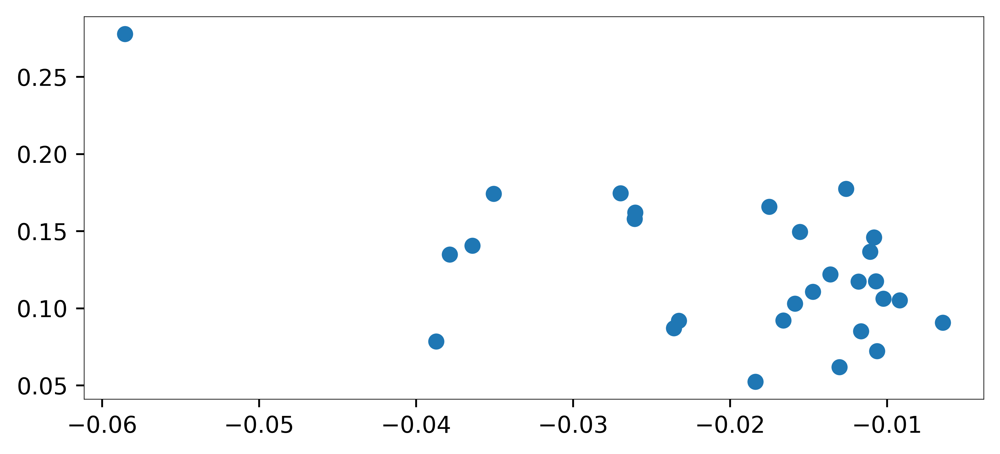

In [ ]:
plt.scatter(delolr2, delpwat2)
np.corrcoef(delolr2, delpwat2)

# CWV-OLR fit based prediction

Clear sky OLR:  306.12808

Regression coefficients:  [[-0.7110288]] [304.7967]
FGOALS-g3 done
Clear sky OLR:  291.88107

Regression coefficients:  [[-1.2269588]] [309.60568]
MPI-ESM1-2-HR done
No clear sky OLR

Regression coefficients:  [[-0.78892016]] [294.4314]
CAS-ESM2-0 done
Clear sky OLR:  301.14444

Regression coefficients:  [[-1.1797397]] [316.99255]
CanESM5 done
Clear sky OLR:  290.32742

Regression coefficients:  [[-1.0701324]] [301.78906]
MPI-ESM1-2-LR done
Clear sky OLR:  302.071

Regression coefficients:  [[-1.2582456]] [321.29004]
BCC-CSM2-MR done
Clear sky OLR:  293.23596

Regression coefficients:  [[-0.5905971]] [300.09775]
INM-CM4-8 done
Clear sky OLR:  288.12366

Regression coefficients:  [[-1.3431168]] [310.23248]
AWI-CM-1-1-MR done
Clear sky OLR:  295.60104

Regression coefficients:  [[-0.59329087]] [294.96042]
KACE-1-0-G done
Clear sky OLR:  294.0874

Regression coefficients:  [[-1.6608565]] [323.78986]
MRI-ESM2-0 done
Clear sky OLR:  291.26544

Regression coefficie

KeyboardInterrupt: 

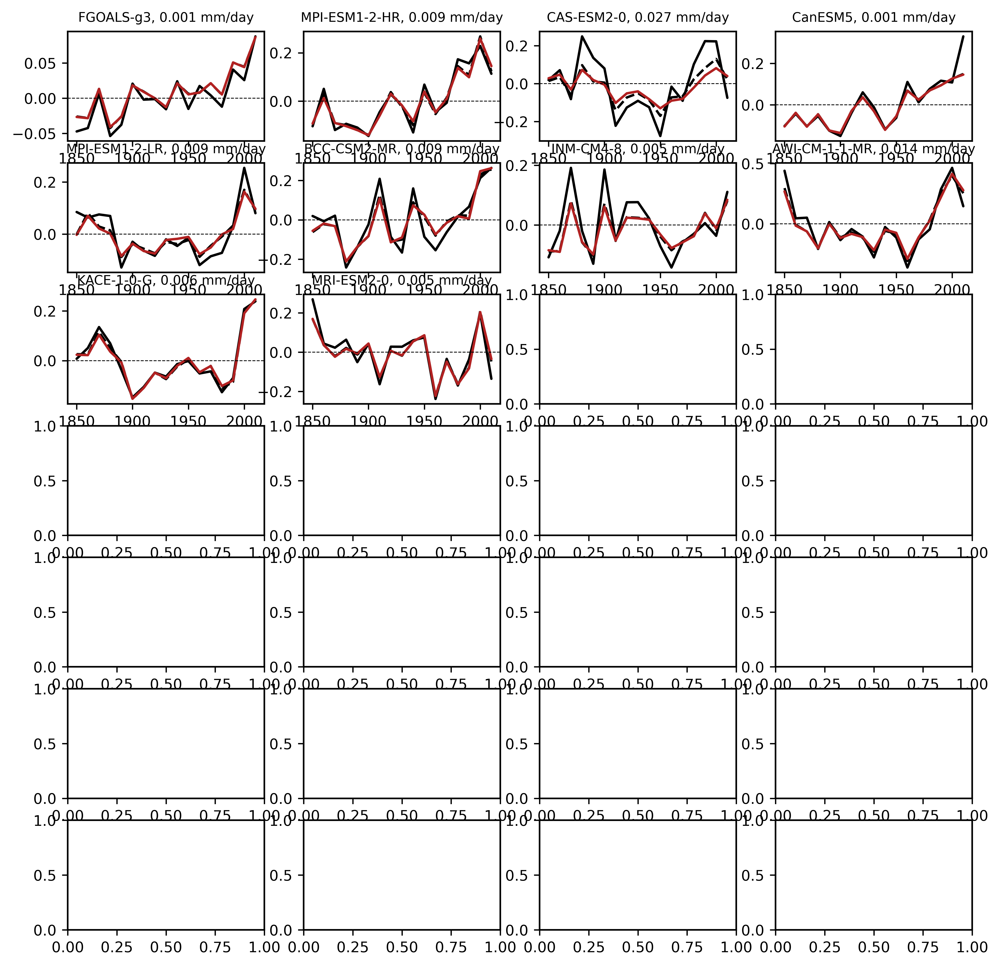

In [ ]:
# Faster code without calculating gamma
plt.rcParams.update({'font.size': 9})
mpl.rcParams['axes.linewidth'] = 1
fig, axs = plt.subplots(nrows=7,ncols=4,
                        figsize=(10,10))
X = np.arange(1850, 2020, 10)
axs=axs.flatten()
rmselist = np.array([])

for i in range(len(models)):
    #First get vertical profile data to calculate lapse rate
    df_ta4 = df.query("table_id == 'Amon' & variable_id == ['pr', 'prw', 'rlut', 'rsdt', 'rsut', 'rlutcs', 'evspsbl'] & experiment_id == ['historical'] & member_id=='r1i1p1f1' & source_id=="+'"'+models[i]+'"')
    zstores = df_ta4.zstore.values
    mappers = [gcs.get_mapper(zstore) for zstore in zstores]
    dl = xr.open_mfdataset(mappers, engine='zarr', consolidated=True, compat='override')

    dl.coords['lon'] = (dl.coords['lon']+180) % 360 -180
    dl2 = dl.sortby(dl.lon)

    grid1 = dl2.sel(lat=slice(lat1,lat2), lon=slice(lon1,lon2))

    sel = range(6, 10)
    months = grid1.time.dt.month.isin(sel) #JJAS
    clim = grid1.sel(time=months)
    clim = clim.resample(time='10YS').mean()  # For decadal

    gammalist = gammas[i]


    #Now get surface data and estimate rainfall
    ds6 = clim
    PE = 26.16*86400*(ds6.pr-ds6.evspsbl).mean(dim=['lat','lon'])
    E = 26.16*86400*ds6.evspsbl.mean(dim=['lat','lon'])
    Qnet = (ds6.rsdt-ds6.rsut-ds6.rlut).mean(dim=['lat','lon'])
    Pwat = ds6.prw.mean(dim=['lat','lon'])
    OLR = ds6.rlut.mean(dim=['lat','lon'])
    x2, y2 = Pwat.values.reshape(-1, 1), OLR.values.reshape(-1, 1)
    regr.fit(x2, y2)
    OLR_pred = regr.predict(x2).reshape(1, -1)
    Qnet_pred = (ds6.rsdt-ds6.rsut).mean(dim=['lat','lon']).values - OLR_pred
    try:
      print('Clear sky OLR: ', np.mean(clim.rlutcs[-1].values))
    except:
      print('No clear sky OLR')
    print('\nRegression coefficients: ', regr.coef_, regr.intercept_)

    TGMS = Qnet/PE
    rec = 1/Pwat

    def objective(X, a, b, c):
      x,y = X
      return a*x + b*y*x + c

    #a1, b1, c1= c1list[i], c2list[i], c3list[i]
    x1, y1 = rec, gammalist
    lower_bounds = [0, -np.inf, -np.inf]
    upper_bounds = [np.inf, 0, np.inf] # This is the key change
    popt1, _ = curve_fit(objective, (x1, y1), TGMS, bounds=(lower_bounds, upper_bounds))

    a1, b1, c1= popt1
    #print(popt1)

    TGMScal = objective((rec, gammalist), a1, b1, c1) #These are calculated TGMS values
    Pcal = Qnet/TGMScal
    Pcal_new = Qnet_pred[0]/TGMScal

    actualp = (PE+E)/26.16
    calculatedp = (np.array(Pcal)+E)/26.16
    newp = (np.array(Pcal_new)+E)/26.16
    mean = np.average(actualp)
    y1 = (actualp - mean).values
    y2 = (calculatedp - mean).values
    y3 = (newp - mean).values
    rmse = mean_squared_error(y2,y3)
    rmselist = np.append(rmselist, np.sqrt(rmse))
    #print(np.corrcoef(y2,y3))

    axs[i].plot(X, y1, color='black', label = 'GCM', solid_capstyle='round')
    axs[i].plot(X, y2, c='k', label='Diagnostic model', linestyle='--')
    axs[i].plot(X, y3, c='firebrick', label='CWV based model', solid_capstyle='round', linewidth=1.5)
    axs[i].set_title(models[i]+', %.3f mm/day' %(rmselist[i]), fontsize=8)
    axs[i].axhline(0, color='k', ls='dashed', lw=0.5)
    #axs[i].fill_between(X, y1, where=(y1 > 0), color='blue', alpha=.3, interpolate=True)
    #axs[i].fill_between(X, y1, where=(y1 < 0), color='red', alpha=.3, interpolate=True)

    print(models[i]+' done')

fig.legend(ncols=3, bbox_to_anchor=(0.25, 1.02, 1., .102),
              loc='lower left', fontsize='large', borderaxespad=0.)
fig.supxlabel('Time')
fig.supylabel('Precipitation anomaly (mm/day)')
plt.tight_layout()
plt.show()

In [ ]:
y1 = np.array([ 0.08801126,  0.05919409, -0.0439074 , -0.16027069, -0.180902  ,
       -0.13101053, -0.15178561, -0.11004591,  0.10883641, -0.00325537,
        0.0166347 , -0.00862241,  0.063658  , -0.03496981,  0.07056618,
        0.23403525,  0.18383503])

In [ ]:
y2 = np.array([ 0.04954836, -0.00382549, -0.0183198 , -0.16327034, -0.13863842,
       -0.10841108, -0.13354842, -0.10910811,  0.06063754, -0.03259141,
        0.00473103,  0.03258896,  0.02395878, -0.00763381,  0.06648374,
        0.26356179,  0.20178499])

In [ ]:
y3 = np.array([ 0.03495526, -0.02121491, -0.00339626, -0.14643109, -0.13013446,
       -0.11510335, -0.13086368, -0.09593179,  0.06411953, -0.01285126,
        0.02478513, -0.00984221,  0.02904302, -0.03657521,  0.04285278,
        0.29587236,  0.19925322])

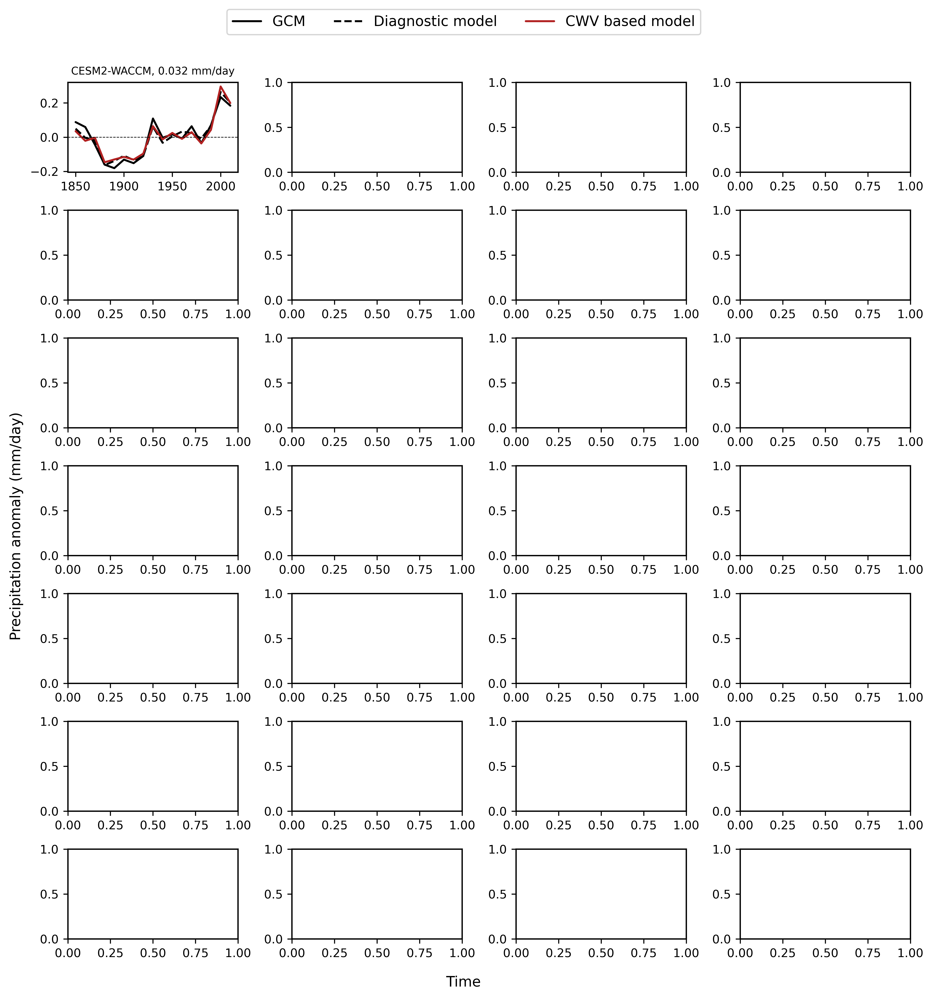

In [ ]:
fig, axs = plt.subplots(nrows=7,ncols=4,
                        figsize=(10,10))
X = np.arange(1850, 2020, 10)
axs=axs.flatten()
axs[i].plot(X, y1, color='black', label = 'GCM', solid_capstyle='round')
axs[i].plot(X, y2, c='k', label='Diagnostic model', solid_capstyle='round', linestyle='--')
axs[i].plot(X, y3, c='firebrick', label='CWV based model', solid_capstyle='round', linewidth=1.5)
axs[i].set_title(models[i]+', %.3f mm/day' %(rmselist[i]), fontsize=8)
axs[i].axhline(0, color='k', ls='dashed', lw=0.5)
#axs[i].fill_between(X, y1, where=(y1 > 0), color='blue', alpha=.3, interpolate=True)
#axs[i].fill_between(X, y1, where=(y1 < 0), color='red', alpha=.3, interpolate=True)

fig.legend(ncols=3, bbox_to_anchor=(0.25, 1.02, 1., .102),
              loc='lower left', fontsize='large', borderaxespad=0.)
fig.supxlabel('Time')
fig.supylabel('Precipitation anomaly (mm/day)')
plt.tight_layout()
plt.show()

In [ ]:
df_ta4 = df.query("table_id == 'Amon' & variable_id == ['cl'] & experiment_id == ['historical'] & member_id=='r1i1p1f1' & source_id=="+'"'+'MPI-ESM-1-2-HAM'+'"')
zstores = df_ta4.zstore.values
mappers = [gcs.get_mapper(zstore) for zstore in zstores]
dl = xr.open_mfdataset(mappers, engine='zarr', consolidated=True, compat='override')
dl.coords['lon'] = (dl.coords['lon']+180) % 360 -180
dl2 = dl.sortby(dl.lon)

grid1 = dl2.sel(lat=slice(lat1,lat2), lon=slice(lon1,lon2))

sel = range(6, 10)
months = grid1.time.dt.month.isin(sel) #JJAS
clim = grid1.sel(time=months)
clim = clim.resample(time='10YS').mean()  # For decadal

In [ ]:
clouds = clim.cl.mean(dim=['lat','lon', 'lev'])

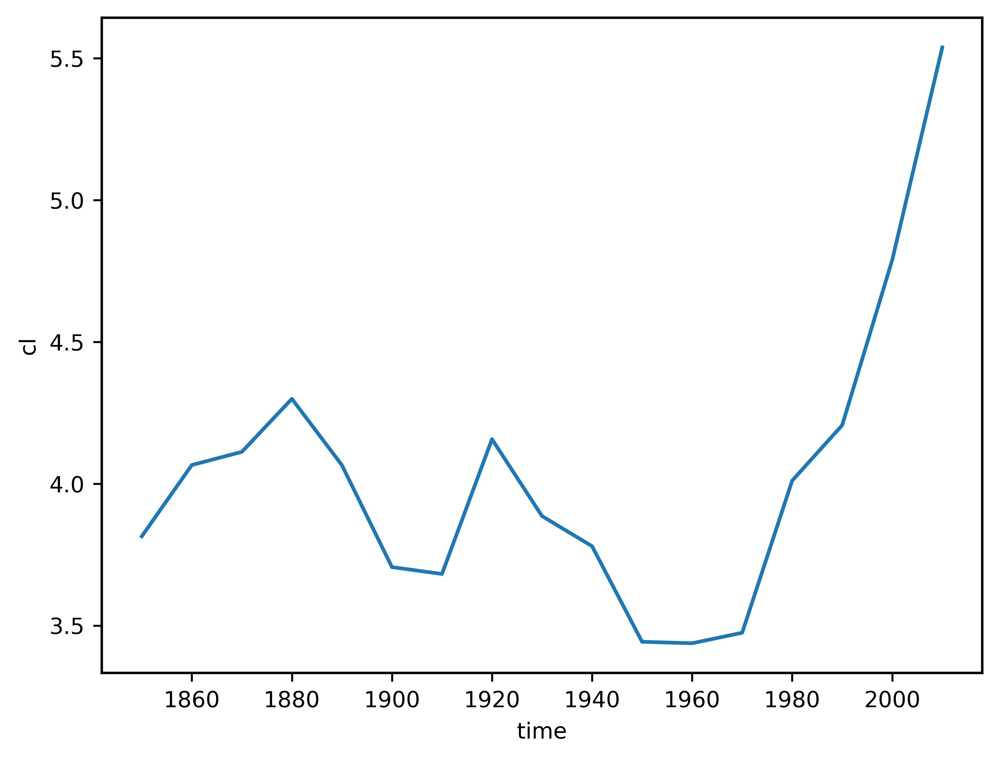

In [ ]:
clouds.plot()